ML PROJECT PHASE 1


In [2]:
import os
import json
import pandas as pd
from docx import Document

# Path to the folder containing the .docx files
folder_path = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Train"
output_csv = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\flights_data2.csv"


# Refined Function to extract text from a .docx file
def extract_text_from_docx(file_path):
    doc = Document(file_path)
    text = []

    # Extract text from paragraphs
    for paragraph in doc.paragraphs:
        if paragraph.text.strip():  # Avoid empty lines
            text.append(paragraph.text.strip())

    # Join all lines to preserve the JSON structure
    return " ".join(text)

flattened_data = []

# Process each .docx file in the folder
for filename in os.listdir(folder_path):
    if filename.endswith(".docx"):
        file_path = os.path.join(folder_path, filename)
        try:
            # Extract text from the .docx file
            file_content = extract_text_from_docx(file_path)
            
            # Parse JSON-like structure
            data = json.loads(file_content)
            
            # Flatten the JSON-like structure
            for flight in data:
                row = {
                    "type": flight.get("type"),
                    "status": flight.get("status"),
                    "departure_iataCode": flight["departure"].get("iataCode"),
                    "departure_icaoCode": flight["departure"].get("icaoCode"),
                    "departure_terminal": flight["departure"].get("terminal"),
                    "departure_scheduledTime": flight["departure"].get("scheduledTime"),
                    "departure_estimatedTime": flight["departure"].get("estimatedTime"),
                    "departure_actualTime": flight["departure"].get("actualTime"),
                    "departure_estimatedRunway": flight["departure"].get("estimatedRunway"),
                    "departure_actualRunway": flight["departure"].get("actualRunway"),
                    "arrival_iataCode": flight["arrival"].get("iataCode"),
                    "arrival_icaoCode": flight["arrival"].get("icaoCode"),
                    "arrival_terminal": flight["arrival"].get("terminal"),
                    "arrival_scheduledTime": flight["arrival"].get("scheduledTime"),
                    "arrival_estimatedTime": flight["arrival"].get("estimatedTime"),
                    "arrival_baggage": flight["arrival"].get("baggage"),
                    "airline_name": flight["airline"].get("name"),
                    "airline_iataCode": flight["airline"].get("iataCode"),
                    "airline_icaoCode": flight["airline"].get("icaoCode"),
                    "flight_number": flight["flight"].get("number"),
                    "flight_iataNumber": flight["flight"].get("iataNumber"),
                    "flight_icaoNumber": flight["flight"].get("icaoNumber"),
                    # Codeshared details
                    "codeshared_airline_name": flight.get("codeshared", {}).get("airline", {}).get("name"),
                    "codeshared_airline_iataCode": flight.get("codeshared", {}).get("airline", {}).get("iataCode"),
                    "codeshared_airline_icaoCode": flight.get("codeshared", {}).get("airline", {}).get("icaoCode"),
                    "codeshared_flight_number": flight.get("codeshared", {}).get("flight", {}).get("number"),
                    "codeshared_flight_iataNumber": flight.get("codeshared", {}).get("flight", {}).get("iataNumber"),
                    "codeshared_flight_icaoNumber": flight.get("codeshared", {}).get("flight", {}).get("icaoNumber"),
                }
                flattened_data.append(row)
        
        except Exception as e:
            print(f"Error processing {file_path}: {e}")

# Convert all records into a DataFrame
df = pd.DataFrame(flattened_data)

# Save the DataFrame to a CSV file
df.to_csv(output_csv, index=False, encoding="utf-8")
print(f"Data has been written to {output_csv}")


Data has been written to C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\flights_data2.csv


In [178]:
# import os
# import json
# import pandas as pd
# from docx import Document

# # Path to the folder containing the .docx files
# folder_path = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Train"
# output_xl = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\flights_data3.xlsx"


# # Refined Function to extract text from a .docx file
# def extract_text_from_docx(file_path):
#     doc = Document(file_path)
#     text = []

#     # Extract text from paragraphs
#     for paragraph in doc.paragraphs:
#         if paragraph.text.strip():  # Avoid empty lines
#             text.append(paragraph.text.strip())

#     # Join all lines to preserve the JSON structure
#     return " ".join(text)

# flattened_data = []

# # Process each .docx file in the folder
# for filename in os.listdir(folder_path):
#     if filename.endswith(".docx"):
#         file_path = os.path.join(folder_path, filename)
#         try:
#             # Extract text from the .docx file
#             file_content = extract_text_from_docx(file_path)
            
#             # Parse JSON-like structure
#             data = json.loads(file_content)
            
#             # Flatten the JSON-like structure
#             for flight in data:
#                 row = {
#                     "type": flight.get("type"),
#                     "status": flight.get("status"),
#                     "departure_iataCode": flight["departure"].get("iataCode"),
#                     "departure_icaoCode": flight["departure"].get("icaoCode"),
#                     "departure_terminal": flight["departure"].get("terminal"),
#                     "departure_scheduledTime": flight["departure"].get("scheduledTime"),
#                     "departure_estimatedTime": flight["departure"].get("estimatedTime"),
#                     "departure_actualTime": flight["departure"].get("actualTime"),
#                     "departure_estimatedRunway": flight["departure"].get("estimatedRunway"),
#                     "departure_actualRunway": flight["departure"].get("actualRunway"),
#                     "arrival_iataCode": flight["arrival"].get("iataCode"),
#                     "arrival_icaoCode": flight["arrival"].get("icaoCode"),
#                     "arrival_terminal": flight["arrival"].get("terminal"),
#                     "arrival_scheduledTime": flight["arrival"].get("scheduledTime"),
#                     "arrival_estimatedTime": flight["arrival"].get("estimatedTime"),
#                     "arrival_baggage": flight["arrival"].get("baggage"),
#                     "airline_name": flight["airline"].get("name"),
#                     "airline_iataCode": flight["airline"].get("iataCode"),
#                     "airline_icaoCode": flight["airline"].get("icaoCode"),
#                     "flight_number": flight["flight"].get("number"),
#                     "flight_iataNumber": flight["flight"].get("iataNumber"),
#                     "flight_icaoNumber": flight["flight"].get("icaoNumber"),
#                     # Codeshared details
#                     "codeshared_airline_name": flight.get("codeshared", {}).get("airline", {}).get("name"),
#                     "codeshared_airline_iataCode": flight.get("codeshared", {}).get("airline", {}).get("iataCode"),
#                     "codeshared_airline_icaoCode": flight.get("codeshared", {}).get("airline", {}).get("icaoCode"),
#                     "codeshared_flight_number": flight.get("codeshared", {}).get("flight", {}).get("number"),
#                     "codeshared_flight_iataNumber": flight.get("codeshared", {}).get("flight", {}).get("iataNumber"),
#                     "codeshared_flight_icaoNumber": flight.get("codeshared", {}).get("flight", {}).get("icaoNumber"),
#                 }
#                 flattened_data.append(row)
        
#         except Exception as e:
#             print(f"Error processing {file_path}: {e}")

# # Convert all records into a DataFrame
# df = pd.DataFrame(flattened_data)

# # Save the DataFrame to a CSV file
# df.to_excel(output_xl,sheet_name='sheet 1', index=False)
# print(f"Data has been written to {output_xl}")


In [ ]:
# import os
# import json
# from docx import Document

# def extract_text_from_docx(file_path):
#     """
#     Extract text from a .docx file.
#     """
#     try:
#         document = Document(file_path)
#         # Combine all paragraphs into a single text block
#         text = "\n".join(paragraph.text for paragraph in document.paragraphs if paragraph.text.strip())
#         return text
#     except Exception as e:
#         print(f"Error reading {file_path}: {e}")
#         return None

# def parse_json_from_text(text):
#     """
#     Parse JSON from text.
#     """
#     try:
#         return json.loads(text)
#     except json.JSONDecodeError as e:
#         print(f"Invalid JSON format: {e}")
#         return None

# def extract_headers_and_data(json_data):
#     """
#     Extract headers and their respective data from JSON.
#     """
#     if isinstance(json_data, list):
#         extracted = []
#         for item in json_data:
#             extracted.append({key: value for key, value in item.items()})
#         return extracted
#     elif isinstance(json_data, dict):
#         return [{key: value for key, value in json_data.items()}]
#     else:
#         return []

# def process_folder(folder_path):
#     """
#     Process all .docx files in a folder and extract headers and data.
#     """
#     all_data = {}

#     for filename in os.listdir(folder_path):
#         if filename.endswith('.docx'):
#             file_path = os.path.join(folder_path, filename)
#             print(f"Processing: {filename}")
            
#             # Extract text from the .docx file
#             text = extract_text_from_docx(file_path)
#             if not text:
#                 continue

#             # Parse the text into JSON format
#             json_data = parse_json_from_text(text)
#             if not json_data:
#                 continue

#             # Extract headers and data
#             extracted_data = extract_headers_and_data(json_data)
#             all_data[filename] = extracted_data

#     return all_data

# def main():
#     folder_path =  r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Train" # Folder containing the .docx files
#     extracted_info = process_folder(folder_path)
    
#     # Output the results
#     for filename, data in extracted_info.items():
#         print(f"\nFile: {filename}")
#         for entry in data:
#             for key, value in entry.items():
#                 print(f"  {key}: {value}")
#         print("\n")

# if __name__ == "__main__":
#     main()


Processing: 1.docx
Processing: 10.docx
Processing: 11.docx
Processing: 12.docx
Processing: 13.docx
Processing: 14.docx
Processing: 15.docx
Processing: 16.docx
Processing: 17.docx
Processing: 18.docx
Processing: 19.docx
Processing: 2.docx
Processing: 20.docx
Processing: 21.docx
Processing: 22.docx
Processing: 23.docx
Processing: 24.docx
Processing: 25.docx
Processing: 26.docx
Processing: 27.docx
Processing: 28.docx
Processing: 29.docx
Processing: 3.docx
Processing: 30.docx
Processing: 31.docx
Processing: 32.docx
Processing: 33.docx
Processing: 34.docx
Processing: 35.docx
Processing: 36.docx
Processing: 37.docx
Processing: 39.docx
Processing: 4.docx
Processing: 40.docx
Processing: 41.docx
Processing: 42.docx
Processing: 43.docx
Processing: 44.docx
Processing: 45.docx
Processing: 46.docx
Processing: 47.docx
Processing: 48.docx
Processing: 49.docx
Processing: 5.docx
Processing: 50.docx
Processing: 51.docx
Processing: 52.docx
Processing: 53.docx
Processing: 54.docx
Processing: 55.docx
Proce

In [179]:
import pandas as pd
import numpy as np

flightData = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\flights_data2.csv"
fdata = pd.read_csv(flightData)
fdata.isnull().sum()

type                                0
status                              0
departure_iataCode                  0
departure_icaoCode                  0
departure_terminal              21750
departure_scheduledTime             0
departure_estimatedTime          7007
departure_actualTime            20582
departure_estimatedRunway       20582
departure_actualRunway          20582
arrival_iataCode                    0
arrival_icaoCode                    0
arrival_terminal                31007
arrival_scheduledTime               0
arrival_estimatedTime           21364
arrival_baggage                 33454
airline_name                        0
airline_iataCode                   29
airline_icaoCode                    0
flight_number                       0
flight_iataNumber                  29
flight_icaoNumber                   0
codeshared_airline_name         35689
codeshared_airline_iataCode     35689
codeshared_airline_icaoCode     35689
codeshared_flight_number        35689
codeshared_f

HANDLING MISSING VALUES

In [181]:
mode_value = fdata['departure_terminal'].dropna().mode()[0]
fdata['departure_terminal'] = fdata['departure_terminal'].fillna(mode_value)

mode_value1 = fdata['arrival_terminal'].dropna().mode()[0]
fdata['arrival_terminal'] = fdata['arrival_terminal'].fillna(mode_value1)

mode_value2 = fdata['arrival_baggage'].dropna().mode()[0]
fdata['arrival_baggage'] = fdata['arrival_baggage'].fillna(mode_value2)

fdata['codeshared_airline_name'] = fdata['codeshared_airline_name'].fillna("No codeshared")
fdata['codeshared_airline_iataCode'] = fdata['codeshared_airline_iataCode'].fillna("No codeshared")
fdata['codeshared_airline_icaoCode'] = fdata['codeshared_airline_iataCode'].fillna("No codeshared")
fdata['codeshared_flight_number'] = fdata['codeshared_flight_number'].fillna("No codeshared")
fdata['codeshared_flight_iataNumber'] = fdata['codeshared_flight_iataNumber'].fillna("No codeshared")
fdata['codeshared_flight_icaoNumber'] = fdata['codeshared_flight_icaoNumber'].fillna("No codeshared")


#fdata['departure_terminal'] = fdata['departure_terminal'].fillna(fdata['departure_terminal'].mode())


In [ ]:
# Ensure the column is in datetime format
fdata['departure_estimatedTime'] = pd.to_datetime(fdata['departure_estimatedTime'], errors='coerce')
fdata['departure_actualTime'] = pd.to_datetime(fdata['departure_actualTime'], errors='coerce')
fdata['departure_estimatedRunway'] = pd.to_datetime(fdata['departure_estimatedRunway'], errors='coerce')
fdata['departure_actualRunway'] = pd.to_datetime(fdata['departure_actualRunway'], errors='coerce')
fdata['arrival_estimatedTime'] = pd.to_datetime(fdata['arrival_estimatedTime'], errors='coerce')
fdata['departure_scheduledTime'] = pd.to_datetime(fdata['departure_scheduledTime'], errors='coerce')
fdata['arrival_scheduledTime'] = pd.to_datetime(fdata['arrival_scheduledTime'], errors='coerce')

fdata['departure_estimatedTime'] = fdata['departure_estimatedTime'].interpolate(method='linear')
fdata['departure_actualTime'] = fdata['departure_actualTime'].interpolate(method='linear')
fdata['departure_estimatedRunway'] = fdata['departure_estimatedRunway'].interpolate(method='linear')
fdata['departure_actualRunway'] = fdata['departure_actualRunway'].interpolate(method='linear')
fdata['arrival_estimatedTime'] = fdata['arrival_estimatedTime'].interpolate(method='linear')




type                             0
status                           0
departure_iataCode               0
departure_icaoCode               0
departure_terminal               0
departure_scheduledTime          0
departure_estimatedTime          0
departure_actualTime             0
departure_estimatedRunway        0
departure_actualRunway           0
arrival_iataCode                 0
arrival_icaoCode                 0
arrival_terminal                 0
arrival_scheduledTime            0
arrival_estimatedTime            0
arrival_baggage                  0
airline_name                     0
airline_iataCode                29
airline_icaoCode                 0
flight_number                    0
flight_iataNumber               29
flight_icaoNumber                0
codeshared_airline_name          0
codeshared_airline_iataCode      0
codeshared_airline_icaoCode      0
codeshared_flight_number         0
codeshared_flight_iataNumber     0
codeshared_flight_icaoNumber     0
dtype: int64

In [175]:
# import pandas as pd

# # Sample data structure assumption:
# # df['airline_iataCode'] has missing values and df['airline_name'] does not have missing values

# # 1. Create a mapping of 'airline_name' to 'airline_iataCode' for the rows where both are not missing
# airline_to_code = fdata.dropna(subset=['airline_iataCode', 'airline_name']).groupby('airline_name')['airline_iataCode'].first().to_dict()

# # Debugging: Check if the mapping is correct
# print("Airline to Code Mapping:", airline_to_code)

# # 2. Use the mapping to fill missing 'airline_iataCode' values
# fdata['airline_iataCode'] = fdata.apply(
#     lambda row: airline_to_code.get(row['airline_name']) if pd.isna(row['airline_iataCode']) else row['airline_iataCode'],
#     axis=1
# )

# # Debugging: Check if 'airline_iataCode' is filled correctly
# print("After filling airline_iataCode:")
# print(fdata[['airline_name', 'airline_iataCode']].head())

# # 3. Fill missing 'flight_iataNumber' by concatenating 'airline_iataCode' with 'flight_iataNumber'
# fdata['flight_iataNumber'] = fdata.apply(
#     lambda row: str(row['airline_iataCode']) + str(row['flight_iataNumber']) if pd.isna(row['flight_iataNumber']) else row['flight_iataNumber'],
#     axis=1
# )

# # Final check
# print("Final DataFrame with filled values:")
# print(fdata[['airline_name', 'airline_iataCode', 'flight_iataNumber']].head())
# fdata

JULY 2023


In [63]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\1.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:31]
        avg_values = values[31:62]
        min_values = values[62:93]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2023-07-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f1.xlsx", index=False)  # Save with a new name



AUGUST 2023

In [64]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\2.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:31]
        avg_values = values[31:62]
        min_values = values[62:93]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2023-08-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f2.xlsx", index=False)  # Save with a new name



SEPTEMBER 2023

In [65]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\3.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:30]
        avg_values = values[30:60]
        min_values = values[60:90]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2023-09-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f3.xlsx", index=False)  # Save with a new name



OCTOBER 2023

In [78]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\4.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:31]
        avg_values = values[31:62]
        min_values = values[62:93]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2023-10-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f4.xlsx", index=False)  # Save with a new name



NOVEMBER 2023

In [79]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\5.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:30]
        avg_values = values[30:60]
        min_values = values[60:90]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2023-11-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f5.xlsx", index=False)  # Save with a new name



DECEMBER 2023

In [80]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\6.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:31]
        avg_values = values[31:62]
        min_values = values[62:93]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2023-12-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f6.xlsx", index=False)  # Save with a new name



JANUARY 2024

In [81]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\7.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:31]
        avg_values = values[31:62]
        min_values = values[62:93]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2024-01-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f7.xlsx", index=False)  # Save with a new name



FEBRUARY 2024

In [82]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\8.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:29]
        avg_values = values[29:58]
        min_values = values[58:87]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2024-02-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f8.xlsx", index=False)  # Save with a new name



MARCH 2024

In [83]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\9.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:31]
        avg_values = values[31:62]
        min_values = values[62:93]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2024-03-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f9.xlsx", index=False)  # Save with a new name



APRIL 2024

In [84]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\10.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:30]
        avg_values = values[30:60]
        min_values = values[60:90]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2024-04-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f10.xlsx", index=False)  # Save with a new name



MAY 2024

In [85]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\11.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:31]
        avg_values = values[31:62]
        min_values = values[62:93]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2024-05-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f11.xlsx", index=False)  # Save with a new name



JUNE 2024

In [86]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\12.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:30]
        avg_values = values[30:60]
        min_values = values[60:90]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2024-06-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f12.xlsx", index=False)  # Save with a new name



JULY 2024

In [87]:
import pandas as pd

# Original DataFrame (simulated for the given description)
data = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Weather\13.xlsx")
df = pd.DataFrame(data)

# Function to process columns with "Max Avg Min" format
def process_column(column_data, has_labels=True):
    values = column_data.split()
    if has_labels:  # If labels are present (Max, Avg, Min)
        values = values[3:]  # Skip the labels
        max_values = values[:14]
        avg_values = values[14:28]
        min_values = values[28:42]
        return max_values, avg_values, min_values
    else:  # No labels, just numerical values
        return values[1:], None, None  # Skip the first label ('Total' or similar)

# Initialize a new DataFrame to hold the formatted data
formatted_data = {'Time': list(range(1, 32))}  # Add day numbers as the 'Time' column

# Process each column
for col in df.columns:
    if col == 'Time':  # Handle Time column separately
        formatted_data['Time'] = df[col][0].split()[1:]  # Extract day numbers
    elif col == 'Precipitation (in)':  # Handle Precipitation column differently
        precip_values, _, _ = process_column(df[col][0], has_labels=False)
        formatted_data['precipitation'] = precip_values
    else:  # Process other columns with "Max Avg Min" labels
        max_vals, avg_vals, min_vals = process_column(df[col][0])
        attribute = col.split(' ')[0].lower()  # Extract attribute name
        formatted_data[f'max_{attribute}'] = max_vals
        formatted_data[f'avg_{attribute}'] = avg_vals
        formatted_data[f'min_{attribute}'] = min_vals

# Create the formatted DataFrame
formatted_df = pd.DataFrame(formatted_data)

# Convert 'Time' to date format assuming starting date is '2023-07-01'
start_date = pd.to_datetime('2024-07-01')  # Adjust the start date as necessary
formatted_df['Time'] = formatted_df['Time'].apply(lambda x: (start_date + pd.Timedelta(days=int(x)-1)).strftime('%y/%m/%d'))

# Display the formatted DataFrame with the 'Date' column
formatted_df.to_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather\f13.xlsx", index=False)  # Save with a new name



In [88]:
import pandas as pd
import os

# Directory containing the Excel files
input_directory = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather"
output_file = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\all_weather.xlsx"

# Get a list of all Excel files in the directory
excel_files = [file for file in os.listdir(input_directory) if file.endswith(('.xls', '.xlsx'))]

# List to store dataframes
dataframes = []

# Read each file and append the dataframe to the list
for file in excel_files:
    file_path = os.path.join(input_directory, file)
    try:
        df = pd.read_excel(file_path)
        dataframes.append(df)
        print(f"Successfully read {file}")
    except Exception as e:
        print(f"Error reading {file}: {e}")

# Concatenate all dataframes
if dataframes:
    concatenated_df = pd.concat(dataframes, ignore_index=True)
    # Write the concatenated dataframe to a new Excel file
    concatenated_df.to_excel(output_file, index=False)
    print(f"Data has been concatenated and saved to {output_file}")
else:
    print("No data to concatenate!")


Successfully read f1.xlsx
Successfully read f10.xlsx
Successfully read f11.xlsx
Successfully read f12.xlsx
Successfully read f13.xlsx
Successfully read f2.xlsx
Successfully read f3.xlsx
Successfully read f4.xlsx
Successfully read f5.xlsx
Successfully read f6.xlsx
Successfully read f7.xlsx
Successfully read f8.xlsx
Successfully read f9.xlsx
Data has been concatenated and saved to C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\all_weather.xlsx


In [96]:
import pandas as pd
import os

# Directory containing the Excel files
input_directory = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\formatted_weather"
output_file = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\all_weather.xlsx"

# Get a sorted list of all Excel files in the directory
excel_files = sorted(
    [file for file in os.listdir(input_directory) if file.endswith(('.xls', '.xlsx'))]
)

# List to store dataframes
dataframes = []

# Read each file and append the dataframe to the list
for file in excel_files:
    file_path = os.path.join(input_directory, file)
    try:
        df = pd.read_excel(file_path)
        dataframes.append(df)
        print(f"Successfully read {file}")
    except Exception as e:
        print(f"Error reading {file}: {e}")

# Concatenate all dataframes
if dataframes:
    concatenated_df = pd.concat(dataframes, ignore_index=True)
    # Write the concatenated dataframe to a new Excel file
    concatenated_df.to_excel(output_file, index=False)
    print(f"Data has been concatenated and saved to {output_file}")
else:
    print("No data to concatenate!")


Successfully read f1.xlsx
Successfully read f10.xlsx
Successfully read f11.xlsx
Successfully read f12.xlsx
Successfully read f13.xlsx
Successfully read f2.xlsx
Successfully read f3.xlsx
Successfully read f4.xlsx
Successfully read f5.xlsx
Successfully read f6.xlsx
Successfully read f7.xlsx
Successfully read f8.xlsx
Successfully read f9.xlsx
Data has been concatenated and saved to C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\all_weather.xlsx


In [191]:
weather = pd.read_excel(r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\all_weather.xlsx")
output_file = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\all_weather1.xlsx"

# Convert the 'Time' column to datetime format
weather['Time'] = pd.to_datetime(weather['Time'], format='%y/%m/%d')

# Sort the DataFrame by the 'Time' column
weather = weather.sort_values(by='Time')

weather.to_excel(output_file, index=False)

weather.info()


<class 'pandas.core.frame.DataFrame'>
Index: 380 entries, 0 to 135
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   Time             380 non-null    datetime64[ns]
 1   max_temperature  380 non-null    float64       
 2   avg_temperature  380 non-null    float64       
 3   min_temperature  380 non-null    float64       
 4   max_dew          380 non-null    float64       
 5   avg_dew          380 non-null    float64       
 6   min_dew          380 non-null    float64       
 7   max_humidity     380 non-null    float64       
 8   avg_humidity     380 non-null    float64       
 9   min_humidity     380 non-null    float64       
 10  max_wind         380 non-null    float64       
 11  avg_wind         380 non-null    float64       
 12  min_wind         380 non-null    float64       
 13  max_pressure     380 non-null    float64       
 14  avg_pressure     380 non-null    float64       

MERGING DATA

In [898]:
# Convert the datetime columns to just the date
fdata['departure_date'] = fdata['departure_scheduledTime'].dt.date
weather['date'] = weather['Time'].dt.date

# Perform the merge using the date columns (inner join)
merged_df = pd.merge(fdata, weather, left_on='departure_date', right_on='date', how='inner')

# Optionally, drop the extra date columns if they are no longer needed
merged_df.drop(['departure_date', 'date', 'precipitation', 'Time'], axis=1, inplace=True)

merged_df


,type,status,departure_iataCode,departure_icaoCode,departure_terminal,departure_scheduledTime,departure_estimatedTime,departure_actualTime,departure_estimatedRunway,departure_actualRunway,...,min_dew,max_humidity,avg_humidity,min_humidity,max_wind,avg_wind,min_wind,max_pressure,avg_pressure,min_pressure
0,departure,active,lhe,opla,m,2023-07-20 20:50:00,2023-07-20 20:00:00,2023-07-20 20:15:00.000000000,2023-07-20 20:15:00.000000000,2023-07-20 20:15:00.000000000,...,79.0,75.0,59.0,89.0,9.5,0.0,13.0,28.9,28.7,28.8
1,departure,active,lhe,opla,m,2023-07-18 15:05:00,2023-07-18 15:05:00,2023-07-22 21:27:00.000000000,2023-07-22 21:27:00.000000000,2023-07-22 21:27:00.000000000,...,77.1,70.0,89.0,83.7,5.0,12.0,7.5,28.8,28.8,28.9
2,departure,active,lhe,opla,m,2023-07-23 09:50:00,2023-07-22 19:17:30,2023-07-24 22:39:00.000000000,2023-07-24 22:39:00.000000000,2023-07-24 22:39:00.000000000,...,79.0,90.4,63.0,94.0,11.9,0.0,25.0,27.1,28.7,28.8
3,departure,active,lhe,opla,m,2023-07-26 23:30:00,2023-07-26 23:30:00,2023-07-26 23:51:00.000000000,2023-07-26 23:51:00.000000000,2023-07-26 23:51:00.000000000,...,77.0,85.3,75.0,94.0,11.2,0.0,9.0,28.8,28.7,28.8
4,departure,active,lhe,opla,m,2023-07-20 11:35:00,2023-07-20 17:15:00,2023-07-26 15:08:34.285714176,2023-07-26 15:08:34.285714176,2023-07-26 15:08:34.285714176,...,79.0,75.0,59.0,89.0,9.5,0.0,13.0,28.9,28.7,28.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51567,departure,active,lhe,opla,m,2023-11-16 09:50:00,2023-11-16 09:50:00,2023-11-16 10:03:00.000000000,2023-11-16 10:03:00.000000000,2023-11-16 10:03:00.000000000,...,55.0,88.0,82.0,88.0,0.0,7.0,9.0,29.3,29.4,29.4
51568,departure,active,lhe,opla,m,2023-11-16 11:40:00,2023-11-16 11:40:00,2023-11-16 11:48:00.000000000,2023-11-16 11:48:00.000000000,2023-11-16 11:48:00.000000000,...,55.0,88.0,82.0,88.0,0.0,7.0,9.0,29.3,29.4,29.4
51569,departure,active,lhe,opla,m,2023-11-27 10:50:00,2023-11-27 14:35:00,2023-11-18 18:07:40.000000000,2023-11-18 18:07:40.000000000,2023-11-18 18:07:40.000000000,...,54.0,54.0,42.0,44.0,0.0,0.0,0.0,29.2,0.0,29.2
51570,departure,active,lhe,opla,m,2023-11-19 02:00:00,2023-11-19 11:00:00,2023-11-21 00:27:20.000000000,2023-11-21 00:27:20.000000000,2023-11-21 00:27:20.000000000,...,55.0,88.0,88.0,88.0,6.0,9.0,12.0,29.3,29.4,29.3


Extracting Temporal features

In [899]:
# Extract temporal features
merged_df['DayOfWeek'] = merged_df['departure_scheduledTime'].dt.day_name()
merged_df['HourOfDay'] = merged_df['departure_scheduledTime'].dt.hour
merged_df['Month'] = merged_df['departure_scheduledTime'].dt.month

merged_df

,type,status,departure_iataCode,departure_icaoCode,departure_terminal,departure_scheduledTime,departure_estimatedTime,departure_actualTime,departure_estimatedRunway,departure_actualRunway,...,min_humidity,max_wind,avg_wind,min_wind,max_pressure,avg_pressure,min_pressure,DayOfWeek,HourOfDay,Month
0,departure,active,lhe,opla,m,2023-07-20 20:50:00,2023-07-20 20:00:00,2023-07-20 20:15:00.000000000,2023-07-20 20:15:00.000000000,2023-07-20 20:15:00.000000000,...,89.0,9.5,0.0,13.0,28.9,28.7,28.8,Thursday,20,7
1,departure,active,lhe,opla,m,2023-07-18 15:05:00,2023-07-18 15:05:00,2023-07-22 21:27:00.000000000,2023-07-22 21:27:00.000000000,2023-07-22 21:27:00.000000000,...,83.7,5.0,12.0,7.5,28.8,28.8,28.9,Tuesday,15,7
2,departure,active,lhe,opla,m,2023-07-23 09:50:00,2023-07-22 19:17:30,2023-07-24 22:39:00.000000000,2023-07-24 22:39:00.000000000,2023-07-24 22:39:00.000000000,...,94.0,11.9,0.0,25.0,27.1,28.7,28.8,Sunday,9,7
3,departure,active,lhe,opla,m,2023-07-26 23:30:00,2023-07-26 23:30:00,2023-07-26 23:51:00.000000000,2023-07-26 23:51:00.000000000,2023-07-26 23:51:00.000000000,...,94.0,11.2,0.0,9.0,28.8,28.7,28.8,Wednesday,23,7
4,departure,active,lhe,opla,m,2023-07-20 11:35:00,2023-07-20 17:15:00,2023-07-26 15:08:34.285714176,2023-07-26 15:08:34.285714176,2023-07-26 15:08:34.285714176,...,89.0,9.5,0.0,13.0,28.9,28.7,28.8,Thursday,11,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51567,departure,active,lhe,opla,m,2023-11-16 09:50:00,2023-11-16 09:50:00,2023-11-16 10:03:00.000000000,2023-11-16 10:03:00.000000000,2023-11-16 10:03:00.000000000,...,88.0,0.0,7.0,9.0,29.3,29.4,29.4,Thursday,9,11
51568,departure,active,lhe,opla,m,2023-11-16 11:40:00,2023-11-16 11:40:00,2023-11-16 11:48:00.000000000,2023-11-16 11:48:00.000000000,2023-11-16 11:48:00.000000000,...,88.0,0.0,7.0,9.0,29.3,29.4,29.4,Thursday,11,11
51569,departure,active,lhe,opla,m,2023-11-27 10:50:00,2023-11-27 14:35:00,2023-11-18 18:07:40.000000000,2023-11-18 18:07:40.000000000,2023-11-18 18:07:40.000000000,...,44.0,0.0,0.0,0.0,29.2,0.0,29.2,Monday,10,11
51570,departure,active,lhe,opla,m,2023-11-19 02:00:00,2023-11-19 11:00:00,2023-11-21 00:27:20.000000000,2023-11-21 00:27:20.000000000,2023-11-21 00:27:20.000000000,...,88.0,6.0,9.0,12.0,29.3,29.4,29.3,Sunday,2,11


DELAYS

In [900]:
# Calculate the departure delay based on actual time
merged_df['departure_delay'] = (merged_df['departure_actualTime'] - merged_df['departure_scheduledTime']).dt.total_seconds() / 60

# Alternatively, calculate the departure delay based on estimated time
#merged_df['departure_delay_estimated'] = (merged_df['departure_estimatedTime'] - merged_df['departure_scheduledTime']).dt.total_seconds() / 60

merged_df



,type,status,departure_iataCode,departure_icaoCode,departure_terminal,departure_scheduledTime,departure_estimatedTime,departure_actualTime,departure_estimatedRunway,departure_actualRunway,...,max_wind,avg_wind,min_wind,max_pressure,avg_pressure,min_pressure,DayOfWeek,HourOfDay,Month,departure_delay
0,departure,active,lhe,opla,m,2023-07-20 20:50:00,2023-07-20 20:00:00,2023-07-20 20:15:00.000000000,2023-07-20 20:15:00.000000000,2023-07-20 20:15:00.000000000,...,9.5,0.0,13.0,28.9,28.7,28.8,Thursday,20,7,-35.000000
1,departure,active,lhe,opla,m,2023-07-18 15:05:00,2023-07-18 15:05:00,2023-07-22 21:27:00.000000000,2023-07-22 21:27:00.000000000,2023-07-22 21:27:00.000000000,...,5.0,12.0,7.5,28.8,28.8,28.9,Tuesday,15,7,6142.000000
2,departure,active,lhe,opla,m,2023-07-23 09:50:00,2023-07-22 19:17:30,2023-07-24 22:39:00.000000000,2023-07-24 22:39:00.000000000,2023-07-24 22:39:00.000000000,...,11.9,0.0,25.0,27.1,28.7,28.8,Sunday,9,7,2209.000000
3,departure,active,lhe,opla,m,2023-07-26 23:30:00,2023-07-26 23:30:00,2023-07-26 23:51:00.000000000,2023-07-26 23:51:00.000000000,2023-07-26 23:51:00.000000000,...,11.2,0.0,9.0,28.8,28.7,28.8,Wednesday,23,7,21.000000
4,departure,active,lhe,opla,m,2023-07-20 11:35:00,2023-07-20 17:15:00,2023-07-26 15:08:34.285714176,2023-07-26 15:08:34.285714176,2023-07-26 15:08:34.285714176,...,9.5,0.0,13.0,28.9,28.7,28.8,Thursday,11,7,8853.571429
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51567,departure,active,lhe,opla,m,2023-11-16 09:50:00,2023-11-16 09:50:00,2023-11-16 10:03:00.000000000,2023-11-16 10:03:00.000000000,2023-11-16 10:03:00.000000000,...,0.0,7.0,9.0,29.3,29.4,29.4,Thursday,9,11,13.000000
51568,departure,active,lhe,opla,m,2023-11-16 11:40:00,2023-11-16 11:40:00,2023-11-16 11:48:00.000000000,2023-11-16 11:48:00.000000000,2023-11-16 11:48:00.000000000,...,0.0,7.0,9.0,29.3,29.4,29.4,Thursday,11,11,8.000000
51569,departure,active,lhe,opla,m,2023-11-27 10:50:00,2023-11-27 14:35:00,2023-11-18 18:07:40.000000000,2023-11-18 18:07:40.000000000,2023-11-18 18:07:40.000000000,...,0.0,0.0,0.0,29.2,0.0,29.2,Monday,10,11,-12522.333333
51570,departure,active,lhe,opla,m,2023-11-19 02:00:00,2023-11-19 11:00:00,2023-11-21 00:27:20.000000000,2023-11-21 00:27:20.000000000,2023-11-21 00:27:20.000000000,...,6.0,9.0,12.0,29.3,29.4,29.3,Sunday,2,11,2787.333333


In [617]:
# merged_df['departure_early'] = merged_df['departure_delay'] < 0
# merged_df.head()


In [651]:
merged_df.isnull().sum()

type                             0
status                           0
departure_iataCode               0
departure_icaoCode               0
departure_terminal               0
departure_scheduledTime          0
departure_estimatedTime          0
departure_actualTime             0
departure_estimatedRunway        0
departure_actualRunway           0
arrival_iataCode                 0
arrival_icaoCode                 0
arrival_terminal                 0
arrival_scheduledTime            0
arrival_estimatedTime            0
arrival_baggage                  0
airline_name                     0
airline_iataCode                29
airline_icaoCode                 0
flight_number                    0
flight_iataNumber               29
flight_icaoNumber                0
codeshared_airline_name          0
codeshared_airline_iataCode      0
codeshared_airline_icaoCode      0
codeshared_flight_number         0
codeshared_flight_iataNumber     0
codeshared_flight_icaoNumber     0
max_temperature     

In [901]:
# Impute missing values with mode for categorical columns
merged_df['flight_iataNumber'].fillna(merged_df['flight_iataNumber'].mode()[0], inplace = True)
merged_df['airline_iataCode'].fillna(merged_df['airline_iataCode'].mode()[0], inplace = True)

# Verify that missing values have been handled
merged_df.isnull().sum()


C:\Users\emadh\AppData\Local\Temp\ipykernel_12924\1225849985.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  merged_df['flight_iataNumber'].fillna(merged_df['flight_iataNumber'].mode()[0], inplace = True)
C:\Users\emadh\AppData\Local\Temp\ipykernel_12924\1225849985.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are se

type                            0
status                          0
departure_iataCode              0
departure_icaoCode              0
departure_terminal              0
departure_scheduledTime         0
departure_estimatedTime         0
departure_actualTime            0
departure_estimatedRunway       0
departure_actualRunway          0
arrival_iataCode                0
arrival_icaoCode                0
arrival_terminal                0
arrival_scheduledTime           0
arrival_estimatedTime           0
arrival_baggage                 0
airline_name                    0
airline_iataCode                0
airline_icaoCode                0
flight_number                   0
flight_iataNumber               0
flight_icaoNumber               0
codeshared_airline_name         0
codeshared_airline_iataCode     0
codeshared_airline_icaoCode     0
codeshared_flight_number        0
codeshared_flight_iataNumber    0
codeshared_flight_icaoNumber    0
max_temperature                 0
avg_temperatur

PHASE 2 : EXPLORATORAY DATA ANALYSIS

1. Delay Distributions (Histogram of Delay Durations)

In [ ]:
# # Calculate mean and standard deviation
# mean_delay = merged_df['departure_delay'].mean()
# std_delay = merged_df['departure_delay'].std()

# # Standardize the column
# x = (merged_df['departure_delay'] - mean_delay) / std_delay
# x.max()

np.float64(34.4746318874928)

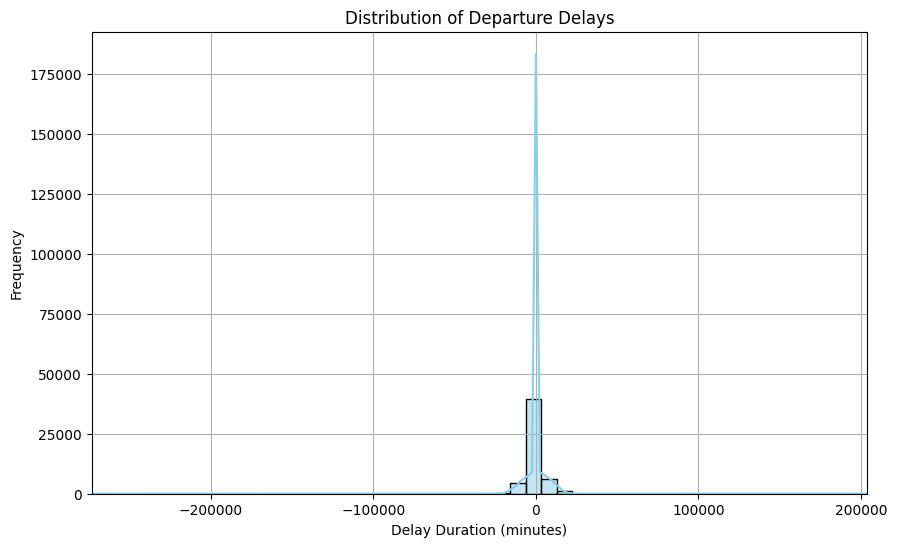

In [621]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plotting histogram for departure delays (considering both early and delayed departures)
# Plotting histogram for departure delays (considering both early and delayed departures)
plt.figure(figsize=(10, 6))
sns.histplot(merged_df['departure_delay'], kde=True, color='skyblue', bins=50)  # Increased bin count for finer resolution
plt.title("Distribution of Departure Delays")
plt.xlabel("Delay Duration (minutes)")
plt.ylabel("Frequency")
plt.xlim(-273200, 203750)  # Adjust the x-axis range for better clarity (you can tweak this range)
plt.grid(True)
plt.show()






2. Temporal Analysis (Delays Across Hours, Days, or Months)

a) Delays Across Hours (Line Plot)

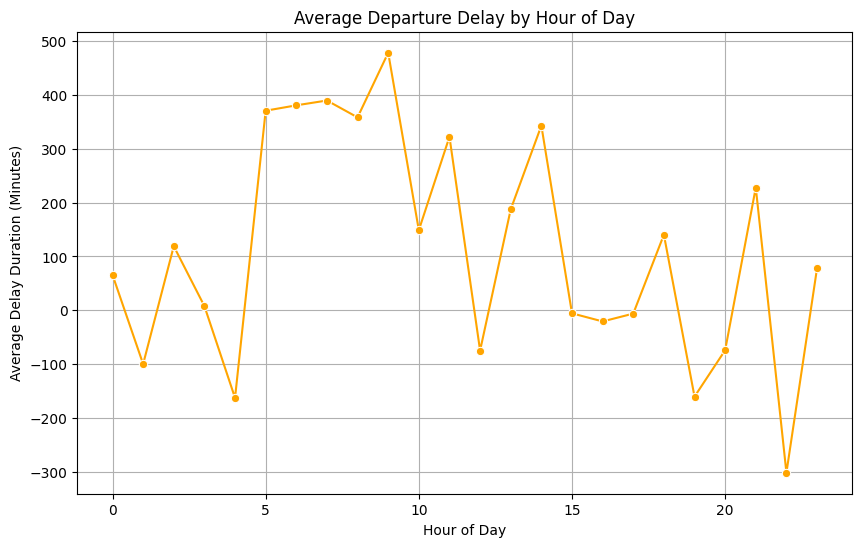

In [622]:
# Extract hour from departure scheduled time
#merged_df['HourOfDay'] = df1['departure_scheduledTime'].dt.hour

# Group by hour and calculate the mean delay
hourly_delay = merged_df.groupby('HourOfDay')['departure_delay'].mean()

# Plotting line chart for delays across hours
plt.figure(figsize=(10, 6))
sns.lineplot(x=hourly_delay.index, y=hourly_delay.values, marker='o', color='orange')
plt.title("Average Departure Delay by Hour of Day")
plt.xlabel("Hour of Day")
plt.ylabel("Average Delay Duration (Minutes)")
plt.grid(True)
plt.show()


b) Delays Across Days (Bar Chart)

C:\Users\emadh\AppData\Local\Temp\ipykernel_12924\2499316320.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=daily_delay.index, y=daily_delay.values, palette='coolwarm')


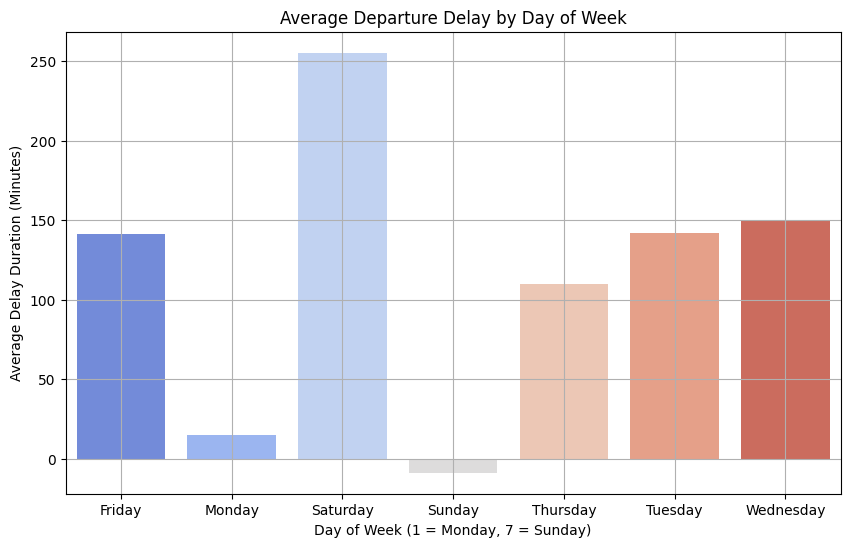

In [623]:
# Group by day of the week and calculate the mean delay
daily_delay = merged_df.groupby('DayOfWeek')['departure_delay'].mean()

# Plotting bar chart for delays across days of the week
plt.figure(figsize=(10, 6))
sns.barplot(x=daily_delay.index, y=daily_delay.values, palette='coolwarm')
plt.title("Average Departure Delay by Day of Week")
plt.xlabel("Day of Week (1 = Monday, 7 = Sunday)")
plt.ylabel("Average Delay Duration (Minutes)")
plt.grid(True)
plt.show()


c) Delays Across Months (Bar Chart)

C:\Users\emadh\AppData\Local\Temp\ipykernel_12924\2626164754.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=monthly_delay.index, y=monthly_delay.values, palette='Blues_d')


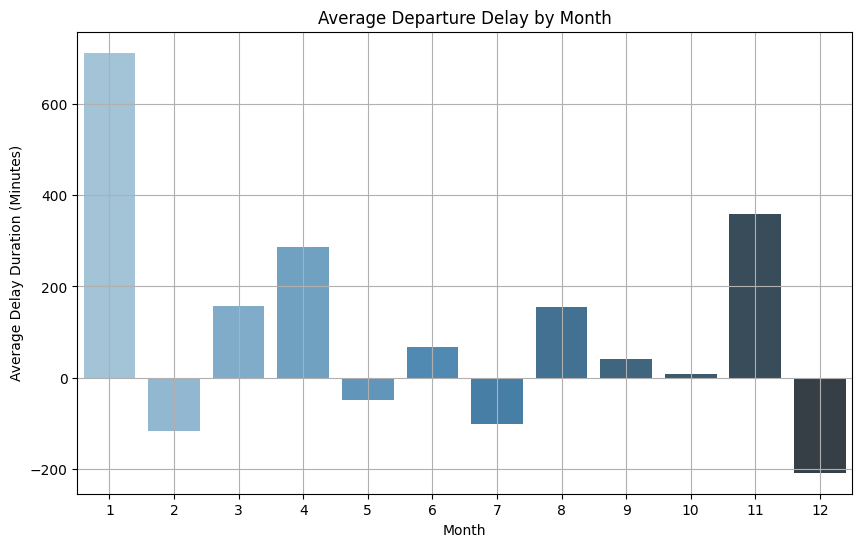

In [624]:
# Group by month and calculate the mean delay
monthly_delay = merged_df.groupby('Month')['departure_delay'].mean()

# Plotting bar chart for delays across months
plt.figure(figsize=(10, 6))
sns.barplot(x=monthly_delay.index, y=monthly_delay.values, palette='Blues_d')
plt.title("Average Departure Delay by Month")
plt.xlabel("Month")
plt.ylabel("Average Delay Duration (Minutes)")
plt.grid(True)
plt.show()


3. Category-Wise Analysis

a) Delays by Airline

C:\Users\emadh\AppData\Local\Temp\ipykernel_12924\1385139376.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=airline_delay_sorted.index, y=airline_delay_sorted.values, palette='viridis')


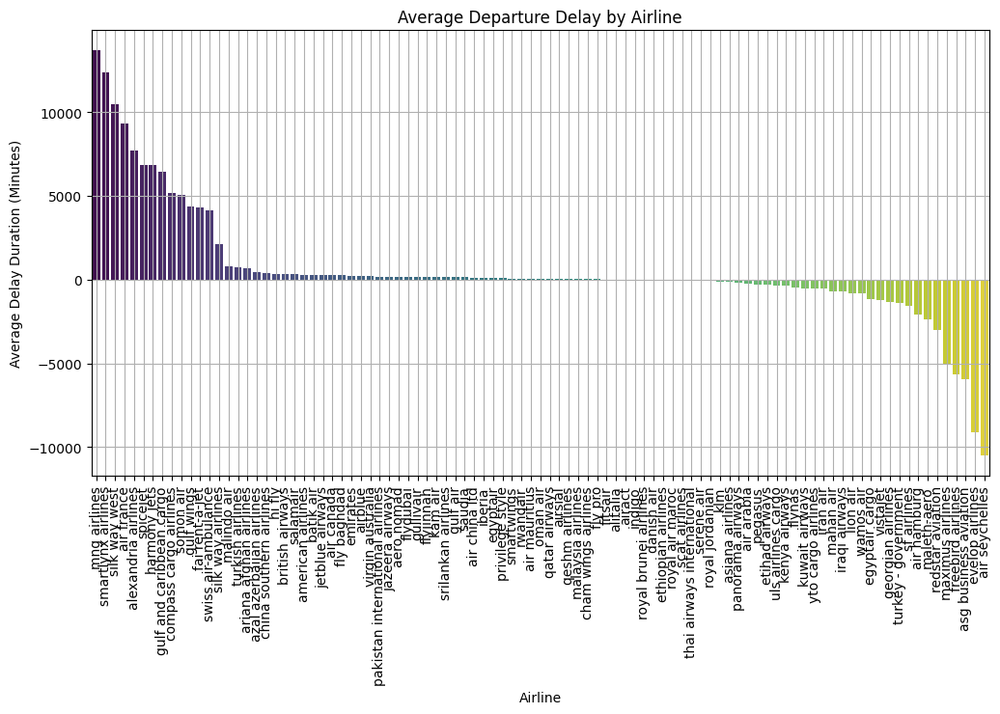

In [625]:
# Group by airline name and calculate the mean delay
airline_delay = merged_df.groupby('airline_name')['departure_delay'].mean()

# Plotting bar chart for delays by airline
plt.figure(figsize=(12, 6))
airline_delay_sorted = airline_delay.sort_values(ascending=False)
sns.barplot(x=airline_delay_sorted.index, y=airline_delay_sorted.values, palette='viridis')
plt.title("Average Departure Delay by Airline")
plt.xlabel("Airline")
plt.ylabel("Average Delay Duration (Minutes)")
plt.xticks(rotation=90)
plt.grid(True)
plt.show()


b) Delays by Departure Airport

C:\Users\emadh\AppData\Local\Temp\ipykernel_12924\4189596226.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=airport_delay_sorted.index, y=airport_delay_sorted.values, palette='coolwarm')


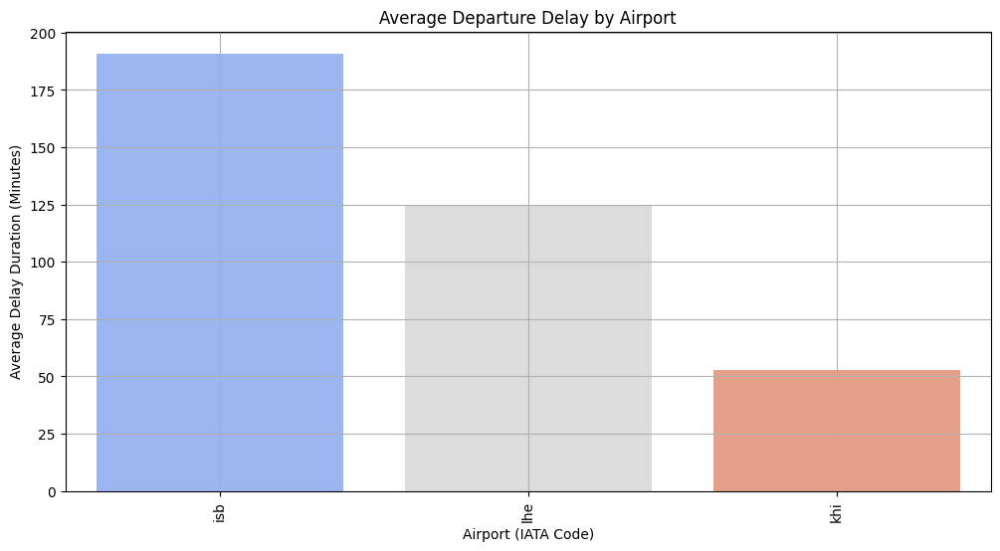

In [626]:
# Group by departure airport and calculate the mean delay
airport_delay = merged_df.groupby('departure_iataCode')['departure_delay'].mean()

# Plotting bar chart for delays by airport
plt.figure(figsize=(12, 6))
airport_delay_sorted = airport_delay.sort_values(ascending=False)
sns.barplot(x=airport_delay_sorted.index, y=airport_delay_sorted.values, palette='coolwarm')
plt.title("Average Departure Delay by Airport")
plt.xlabel("Airport (IATA Code)")
plt.ylabel("Average Delay Duration (Minutes)")
plt.xticks(rotation=90)
plt.grid(True)
plt.show()


c) Delays by Flight Status

C:\Users\emadh\AppData\Local\Temp\ipykernel_12924\1974991932.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=status_delay.index, y=status_delay.values, palette='Set2')


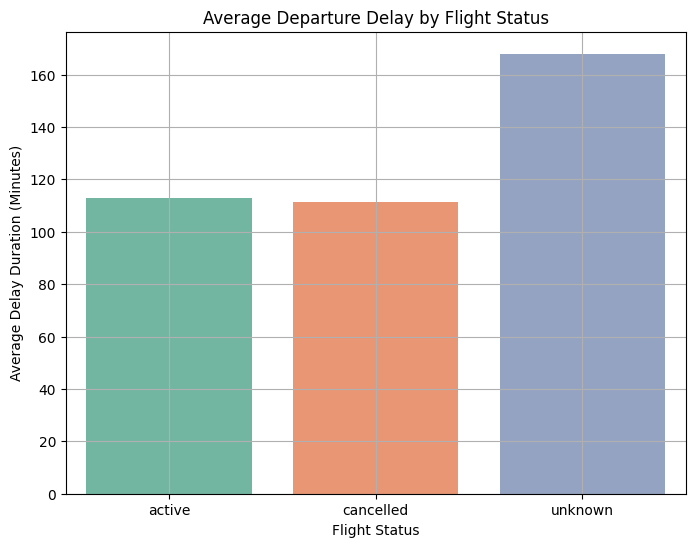

In [627]:
# Group by flight status and calculate the mean delay
status_delay = merged_df.groupby('status')['departure_delay'].mean()

# Plotting bar chart for delays by flight status
plt.figure(figsize=(8, 6))
sns.barplot(x=status_delay.index, y=status_delay.values, palette='Set2')
plt.title("Average Departure Delay by Flight Status")
plt.xlabel("Flight Status")
plt.ylabel("Average Delay Duration (Minutes)")
plt.grid(True)
plt.show()


2. Correlation Analysis

In [628]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51572 entries, 0 to 51571
Data columns (total 48 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   type                          51572 non-null  object        
 1   status                        51572 non-null  object        
 2   departure_iataCode            51572 non-null  object        
 3   departure_icaoCode            51572 non-null  object        
 4   departure_terminal            51572 non-null  object        
 5   departure_scheduledTime       51572 non-null  datetime64[ns]
 6   departure_estimatedTime       51572 non-null  datetime64[ns]
 7   departure_actualTime          51572 non-null  datetime64[ns]
 8   departure_estimatedRunway     51572 non-null  datetime64[ns]
 9   departure_actualRunway        51572 non-null  datetime64[ns]
 10  arrival_iataCode              51572 non-null  object        
 11  arrival_icaoCode            

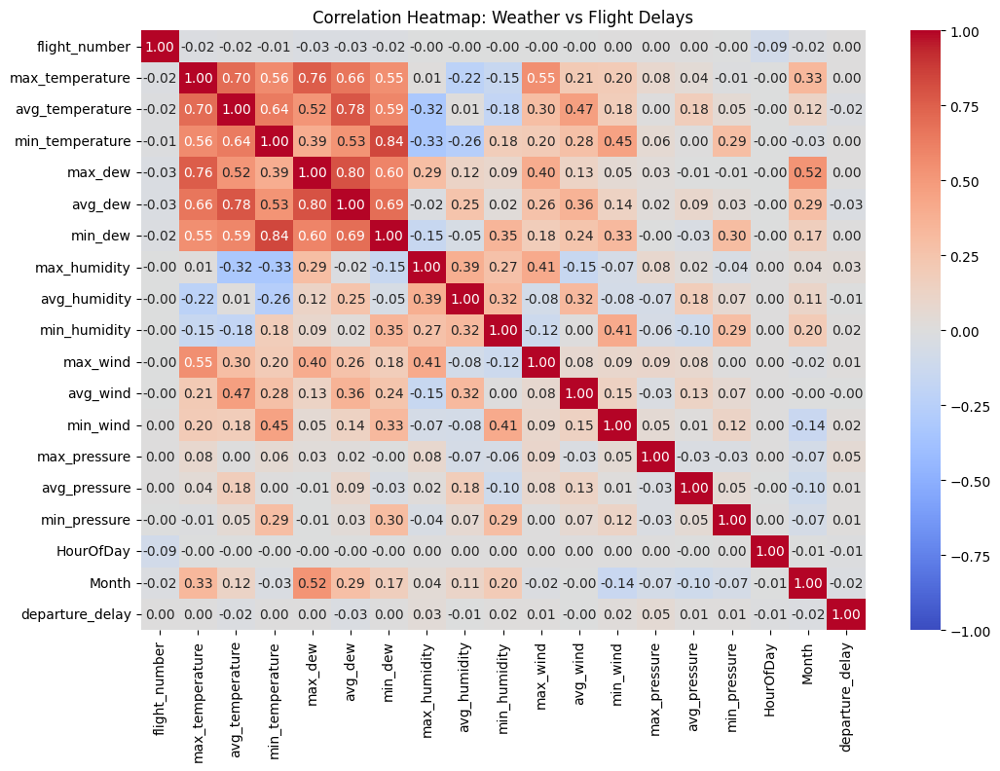

In [657]:

# Select only numeric columns for correlation calculation
numeric_columns = merged_df.select_dtypes(include=['number'])

# Calculate correlation matrix
correlation_matrix = numeric_columns.corr()

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', vmin=-1, vmax=1)
plt.title('Correlation Heatmap: Weather vs Flight Delays')
plt.show()




In [658]:

target_correlation = correlation_matrix['departure_delay'].sort_values(ascending=False)
target_correlation


departure_delay    1.000000
max_pressure       0.047374
max_humidity       0.032733
min_wind           0.019801
min_humidity       0.015526
avg_pressure       0.011066
max_wind           0.010289
min_pressure       0.007913
min_dew            0.004902
min_temperature    0.004351
max_dew            0.002329
flight_number      0.002024
max_temperature    0.000389
avg_wind          -0.000485
avg_humidity      -0.007718
HourOfDay         -0.008415
avg_temperature   -0.016534
Month             -0.018478
avg_dew           -0.025638
Name: departure_delay, dtype: float64

2. Scatter Plot of Delay vs Pressure:

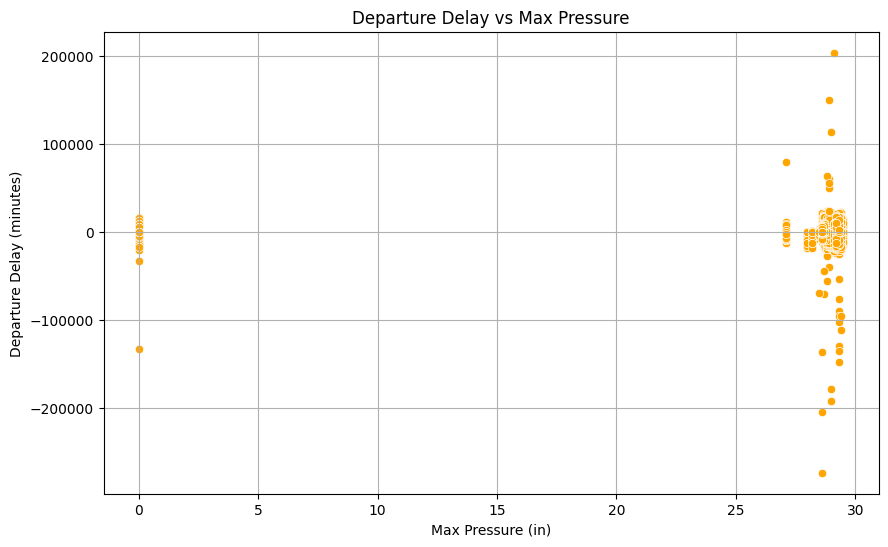

In [631]:
# Scatter plot between departure delay and average temperature
plt.figure(figsize=(10, 6))
sns.scatterplot(data=merged_df, x='max_pressure', y='departure_delay', color='orange')
plt.title('Departure Delay vs Max Pressure')
plt.xlabel('Max Pressure (in)')
plt.ylabel('Departure Delay (minutes)')
plt.grid(True)
plt.show()


3. Line Plot of Delay vs Humidity:

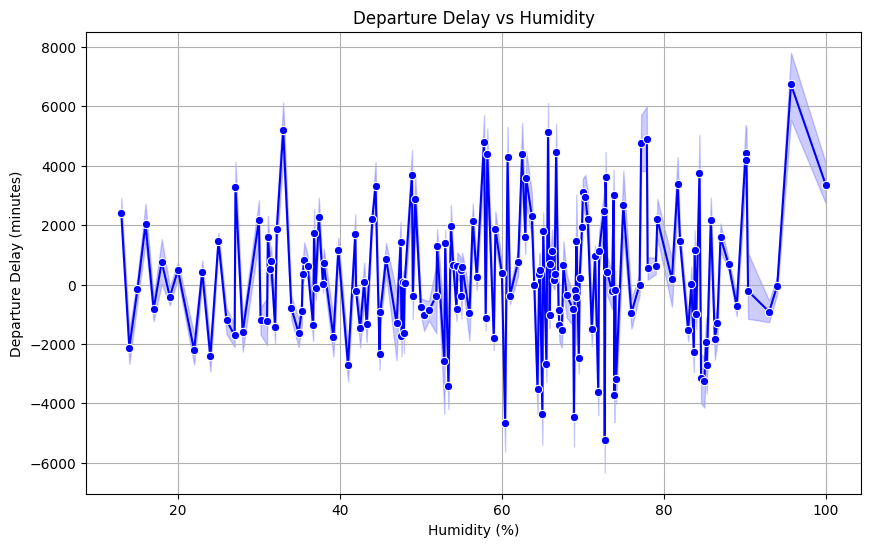

In [632]:
# Line plot of delay vs precipitation
plt.figure(figsize=(10, 6))
sns.lineplot(data=merged_df, x='max_humidity', y='departure_delay', color='blue', marker='o')
plt.title('Departure Delay vs Humidity')
plt.xlabel('Humidity (%)')
plt.ylabel('Departure Delay (minutes)')
plt.grid(True)
plt.show()


3. Comparison

In [633]:
# from sklearn.model_selection import train_test_split

# # Split the merged data into training and testing sets (e.g., 80% for training, 20% for testing)
# train_df, test_df = train_test_split(merged_df, test_size=0.2, random_state=42)

# # Display the shape of both sets to verify the split
# print(f"Training data shape: {train_df.shape}")
# print(f"Testing data shape: {test_df.shape}")


In [634]:
# # Calculate delay statistics for the training and testing datasets
# train_delay_stats = train_df['departure_delay'].describe()
# test_delay_stats = test_df['departure_delay'].describe()

# # Print the statistics
# print("Training Data Delay Statistics:")
# print(train_delay_stats)

# print("\nTesting Data Delay Statistics:")
# print(test_delay_stats)


In [635]:
# import matplotlib.pyplot as plt
# import seaborn as sns

# # Scatterplot to compare departure delays between training and testing datasets
# plt.figure(figsize=(10, 6))

# # Scatterplot for training data (using blue dots)
# sns.scatterplot(x=train_df.index, y=train_df['departure_delay'], color='blue', label='Training Data', alpha=0.5)

# # Scatterplot for testing data (using orange dots)
# sns.scatterplot(x=test_df.index, y=test_df['departure_delay'], color='orange', label='Testing Data', alpha=0.5)

# # Set the title and labels
# plt.title('Comparison of Departure Delays (Training vs Testing)', fontsize=14)
# plt.xlabel('Index (Flight Entries)', fontsize=12)
# plt.ylabel('Departure Delay (minutes)', fontsize=12)
# plt.legend()

# # Show the plot
# plt.show()


In [272]:
import os
import json
import pandas as pd
from docx import Document

# Path to the folder containing the .docx files
folder_path = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\Test"
test_xl = r"C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\test_data.xlsx"


# Refined Function to extract text from a .docx file
def extract_text_from_docx(file_path):
    doc = Document(file_path)
    text = []

    # Extract text from paragraphs
    for paragraph in doc.paragraphs:
        if paragraph.text.strip():  # Avoid empty lines
            text.append(paragraph.text.strip())

    # Join all lines to preserve the JSON structure
    return " ".join(text)

flattened_data = []

# Process each .docx file in the folder
for filename in os.listdir(folder_path):
    if filename.endswith(".docx"):
        file_path = os.path.join(folder_path, filename)
        try:
            # Extract text from the .docx file
            file_content = extract_text_from_docx(file_path)
            
            # Parse JSON-like structure
            data = json.loads(file_content)
            
            # Flatten the JSON-like structure
            for flight in data:
                row = {
                    "type": flight.get("type"),
                    "status": flight.get("status"),
                    "departure_iataCode": flight["departure"].get("iataCode"),
                    "departure_icaoCode": flight["departure"].get("icaoCode"),
                    "departure_terminal": flight["departure"].get("terminal"),
                    "departure_scheduledTime": flight["departure"].get("scheduledTime"),
                    "departure_estimatedTime": flight["departure"].get("estimatedTime"),
                    "departure_actualTime": flight["departure"].get("actualTime"),
                    "departure_estimatedRunway": flight["departure"].get("estimatedRunway"),
                    "departure_actualRunway": flight["departure"].get("actualRunway"),
                    "arrival_iataCode": flight["arrival"].get("iataCode"),
                    "arrival_icaoCode": flight["arrival"].get("icaoCode"),
                    "arrival_terminal": flight["arrival"].get("terminal"),
                    "arrival_scheduledTime": flight["arrival"].get("scheduledTime"),
                    "arrival_estimatedTime": flight["arrival"].get("estimatedTime"),
                    "arrival_baggage": flight["arrival"].get("baggage"),
                    "airline_name": flight["airline"].get("name"),
                    "airline_iataCode": flight["airline"].get("iataCode"),
                    "airline_icaoCode": flight["airline"].get("icaoCode"),
                    "flight_number": flight["flight"].get("number"),
                    "flight_iataNumber": flight["flight"].get("iataNumber"),
                    "flight_icaoNumber": flight["flight"].get("icaoNumber"),
                    # Codeshared details
                    "codeshared_airline_name": flight.get("codeshared", {}).get("airline", {}).get("name"),
                    "codeshared_airline_iataCode": flight.get("codeshared", {}).get("airline", {}).get("iataCode"),
                    "codeshared_airline_icaoCode": flight.get("codeshared", {}).get("airline", {}).get("icaoCode"),
                    "codeshared_flight_number": flight.get("codeshared", {}).get("flight", {}).get("number"),
                    "codeshared_flight_iataNumber": flight.get("codeshared", {}).get("flight", {}).get("iataNumber"),
                    "codeshared_flight_icaoNumber": flight.get("codeshared", {}).get("flight", {}).get("icaoNumber"),
                }
                flattened_data.append(row)
        
        except Exception as e:
            print(f"Error processing {file_path}: {e}")

# Convert all records into a DataFrame
test = pd.DataFrame(flattened_data)

# Save the DataFrame to a CSV file
test.to_excel(test_xl, sheet_name = 'sheet 1', index=False)
print(f"Data has been written to {test_xl}")


Data has been written to C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\test_data.xlsx


In [659]:
test['departure_estimatedTime'] = pd.to_datetime(test['departure_estimatedTime'], errors='coerce')
test['departure_actualTime'] = pd.to_datetime(test['departure_actualTime'], errors='coerce')
test['departure_estimatedRunway'] = pd.to_datetime(test['departure_estimatedRunway'], errors='coerce')
test['departure_actualRunway'] = pd.to_datetime(test['departure_actualRunway'], errors='coerce')
test['arrival_estimatedTime'] = pd.to_datetime(test['arrival_estimatedTime'], errors='coerce')
test['departure_scheduledTime'] = pd.to_datetime(test['departure_scheduledTime'], errors='coerce')
test['arrival_scheduledTime'] = pd.to_datetime(test['arrival_scheduledTime'], errors='coerce')


In [660]:
test['departure_estimatedTime'] = fdata['departure_estimatedTime'].interpolate(method='linear')
test['departure_actualTime'] = fdata['departure_actualTime'].interpolate(method='linear')
test['departure_estimatedRunway'] = fdata['departure_estimatedRunway'].interpolate(method='linear')
test['departure_actualRunway'] = fdata['departure_actualRunway'].interpolate(method='linear')
test['arrival_estimatedTime'] = fdata['arrival_estimatedTime'].interpolate(method='linear')


In [828]:
test['departure_date'] = test['departure_scheduledTime'].dt.date
merged_test = pd.merge(test, weather, left_on='departure_date', right_on='date', how='inner')
merged_test.drop(['departure_date', 'date', 'precipitation', 'Time'], axis=1, inplace=True)
merged_test.head()

,type,status,departure_iataCode,departure_icaoCode,departure_terminal,departure_scheduledTime,departure_estimatedTime,departure_actualTime,departure_estimatedRunway,departure_actualRunway,...,min_dew,max_humidity,avg_humidity,min_humidity,max_wind,avg_wind,min_wind,max_pressure,avg_pressure,min_pressure
0,departure,active,lhe,opla,None,2023-07-17 20:35:00,2023-07-20 20:00:00,2023-07-20 20:15:00.000000000,2023-07-20 20:15:00.000000000,2023-07-20 20:15:00.000000000,...,79.0,81.7,70.0,100.0,12.7,5.0,16.0,28.8,28.8,28.9
1,departure,active,lhe,opla,m,2023-07-27 08:00:00,2023-07-18 15:05:00,2023-07-22 21:27:00.000000000,2023-07-22 21:27:00.000000000,2023-07-22 21:27:00.000000000,...,75.5,74.0,89.0,73.3,0.0,12.0,3.2,28.8,28.9,28.8
2,departure,active,lhe,opla,m,2023-07-27 08:00:00,2023-07-22 19:17:30,2023-07-24 22:39:00.000000000,2023-07-24 22:39:00.000000000,2023-07-24 22:39:00.000000000,...,75.5,74.0,89.0,73.3,0.0,12.0,3.2,28.8,28.9,28.8
3,departure,unknown,lhe,opla,m,2023-07-28 16:45:00,2023-07-26 23:30:00,2023-07-26 23:51:00.000000000,2023-07-26 23:51:00.000000000,2023-07-26 23:51:00.000000000,...,73.0,89.0,76.0,56.0,16.0,5.3,0.0,28.9,28.8,28.7
4,departure,active,lhe,opla,m,2023-07-19 04:15:00,2023-07-20 17:15:00,2023-07-26 15:08:34.285714176,2023-07-26 15:08:34.285714176,2023-07-26 15:08:34.285714176,...,73.0,89.0,71.3,70.0,15.0,6.9,0.0,28.9,28.8,28.8


In [829]:
# Calculate the departure delay based on actual time
merged_test['departure_delay'] = (merged_test['departure_actualTime'] - merged_test['departure_scheduledTime']).dt.total_seconds() / 60

# Alternatively, calculate the departure delay based on estimated time
#merged_test['departure_delay_estimated'] = (merged_test['departure_estimatedTime'] - merged_df['departure_scheduledTime']).dt.total_seconds() / 60



merged_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14910 entries, 0 to 14909
Data columns (total 44 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   type                          14910 non-null  object        
 1   status                        14910 non-null  object        
 2   departure_iataCode            14910 non-null  object        
 3   departure_icaoCode            14910 non-null  object        
 4   departure_terminal            8434 non-null   object        
 5   departure_scheduledTime       14910 non-null  datetime64[ns]
 6   departure_estimatedTime       14910 non-null  datetime64[ns]
 7   departure_actualTime          14910 non-null  datetime64[ns]
 8   departure_estimatedRunway     14910 non-null  datetime64[ns]
 9   departure_actualRunway        14910 non-null  datetime64[ns]
 10  arrival_iataCode              14910 non-null  object        
 11  arrival_icaoCode            

In [640]:
# merged_test['departure_early'] = merged_test['departure_delay'] < 0
# merged_test.head()


In [830]:
# Extract temporal features
merged_test['DayOfWeek'] = merged_test['departure_scheduledTime'].dt.day_name()
merged_test['HourOfDay'] = merged_test['departure_scheduledTime'].dt.hour
merged_test['Month'] = merged_test['departure_scheduledTime'].dt.month

merged_test['flight_number'] = merged_test['flight_number'].astype(int)
merged_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14910 entries, 0 to 14909
Data columns (total 47 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   type                          14910 non-null  object        
 1   status                        14910 non-null  object        
 2   departure_iataCode            14910 non-null  object        
 3   departure_icaoCode            14910 non-null  object        
 4   departure_terminal            8434 non-null   object        
 5   departure_scheduledTime       14910 non-null  datetime64[ns]
 6   departure_estimatedTime       14910 non-null  datetime64[ns]
 7   departure_actualTime          14910 non-null  datetime64[ns]
 8   departure_estimatedRunway     14910 non-null  datetime64[ns]
 9   departure_actualRunway        14910 non-null  datetime64[ns]
 10  arrival_iataCode              14910 non-null  object        
 11  arrival_icaoCode            

In [831]:
mode_value = merged_test['departure_terminal'].dropna().mode()[0]
merged_test['departure_terminal'] = merged_test['departure_terminal'].fillna(mode_value)

mode_value1 = merged_test['arrival_terminal'].dropna().mode()[0]
merged_test['arrival_terminal'] = merged_test['arrival_terminal'].fillna(mode_value1)

mode_value2 = merged_test['arrival_baggage'].dropna().mode()[0]
merged_test['arrival_baggage'] = merged_test['arrival_baggage'].fillna(mode_value2)

merged_test['codeshared_airline_name'] = merged_test['codeshared_airline_name'].fillna("No codeshared")
merged_test['codeshared_airline_iataCode'] = merged_test['codeshared_airline_iataCode'].fillna("No codeshared")
merged_test['codeshared_airline_icaoCode'] = merged_test['codeshared_airline_iataCode'].fillna("No codeshared")
merged_test['codeshared_flight_number'] = merged_test['codeshared_flight_number'].fillna("No codeshared")
merged_test['codeshared_flight_iataNumber'] = merged_test['codeshared_flight_iataNumber'].fillna("No codeshared")
merged_test['codeshared_flight_icaoNumber'] = merged_test['codeshared_flight_icaoNumber'].fillna("No codeshared")

In [716]:
merged_test.isnull().sum()

type                            0
status                          0
departure_iataCode              0
departure_icaoCode              0
departure_terminal              0
departure_scheduledTime         0
departure_estimatedTime         0
departure_actualTime            0
departure_estimatedRunway       0
departure_actualRunway          0
arrival_iataCode                0
arrival_icaoCode                0
arrival_terminal                0
arrival_scheduledTime           0
arrival_estimatedTime           0
arrival_baggage                 0
airline_name                    0
airline_iataCode                0
airline_icaoCode                0
flight_number                   0
flight_iataNumber               0
flight_icaoNumber               0
codeshared_airline_name         0
codeshared_airline_iataCode     0
codeshared_airline_icaoCode     0
codeshared_flight_number        0
codeshared_flight_iataNumber    0
codeshared_flight_icaoNumber    0
max_temperature                 0
avg_temperatur

PHASE 3: Analytical and Predictive Tasks

Binary Classification

In [ ]:
# merged_df['is_weekend'] = merged_df['DayOfWeek'].isin([6, 7]).astype(int)
# merged_df['season'] = merged_df['Month'].map({
#     12: 'Winter', 1: 'Winter', 2: 'Winter',
#     3: 'Spring', 4: 'Spring', 5: 'Spring',
#     6: 'Summer', 7: 'Summer', 8: 'Summer',
#     9: 'Autumn', 10: 'Autumn', 11: 'Autumn'
# })

In [823]:
# Convert the 'delay' column into binary string labels
merged_df['delay_status'] = merged_df['departure_delay'].apply(lambda x: "on-time" if x <= 0 else "delayed")
merged_df['delay_status'] = merged_df['delay_status'].astype(str)
#merged_df['codeshared_flight_number'] = merged_df['codeshared_flight_number'].astype(int)

merged_df.info()



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51572 entries, 0 to 51571
Data columns (total 48 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   type                          51572 non-null  object        
 1   status                        51572 non-null  object        
 2   departure_iataCode            51572 non-null  object        
 3   departure_icaoCode            51572 non-null  object        
 4   departure_terminal            51572 non-null  object        
 5   departure_scheduledTime       51572 non-null  datetime64[ns]
 6   departure_estimatedTime       51572 non-null  datetime64[ns]
 7   departure_actualTime          51572 non-null  datetime64[ns]
 8   departure_estimatedRunway     51572 non-null  datetime64[ns]
 9   departure_actualRunway        51572 non-null  datetime64[ns]
 10  arrival_iataCode              51572 non-null  object        
 11  arrival_icaoCode            

In [ ]:
# merged_df['departure_early'] = merged_df['departure_delay'] < 0
# merged_df.head()


In [528]:
# from sklearn.model_selection import train_test_split

# # Define features and target
# X = merged_df.select_dtypes(include=['number'])
# #X = X.drop(['departure_delay', 'departure_delay_estimated'], axis=1)  
# y = merged_df['delay_status']  # Target variable

# # Perform train-test split
# X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# print("Training set size:", X_train.shape)
# print("Validation set size:", X_val.shape)

# X,y

In [680]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51572 entries, 0 to 51571
Data columns (total 48 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   type                          51572 non-null  object        
 1   status                        51572 non-null  object        
 2   departure_iataCode            51572 non-null  object        
 3   departure_icaoCode            51572 non-null  object        
 4   departure_terminal            51572 non-null  object        
 5   departure_scheduledTime       51572 non-null  datetime64[ns]
 6   departure_estimatedTime       51572 non-null  datetime64[ns]
 7   departure_actualTime          51572 non-null  datetime64[ns]
 8   departure_estimatedRunway     51572 non-null  datetime64[ns]
 9   departure_actualRunway        51572 non-null  datetime64[ns]
 10  arrival_iataCode              51572 non-null  object        
 11  arrival_icaoCode            

In [795]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

# Define categorical and numerical columns
categorical_features = ['DayOfWeek', 'airline_name', 'status','type', 'departure_terminal']
numerical_features = [
    'Month', 'avg_pressure',
    'avg_temperature',
    'avg_humidity',
    'avg_wind','HourOfDay'
]

# One-Hot Encode categorical features
preprocessor = ColumnTransformer(
    transformers=[
        ('num', 'passthrough', numerical_features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ]
)

# Transform features
X = preprocessor.fit_transform(merged_df)
y = merged_df['delay_status']


In [800]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=30)


In [801]:
from sklearn.ensemble import RandomForestClassifier
rf_model = RandomForestClassifier(random_state=30)
rf_model.fit(X_train, y_train)

from sklearn.metrics import classification_report, accuracy_score
y_pred = rf_model.predict(X_test)
print(accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))


0.7345484512094624
              precision    recall  f1-score   support

     delayed       0.51      0.35      0.42      5566
     on-time       0.78      0.88      0.83     15063

    accuracy                           0.73     20629
   macro avg       0.65      0.61      0.62     20629
weighted avg       0.71      0.73      0.72     20629



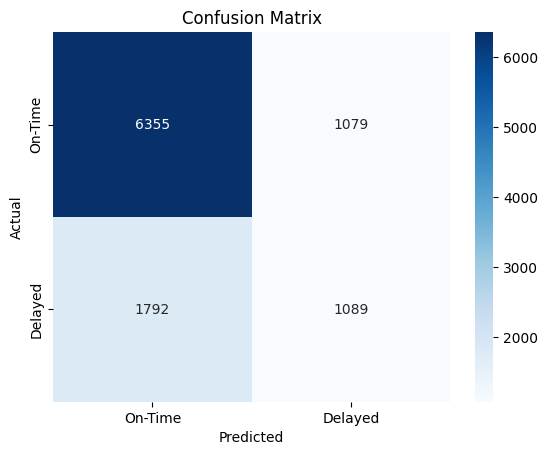

In [741]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Compute confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['On-Time', 'Delayed'], yticklabels=['On-Time', 'Delayed'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


In [ ]:
# Preprocess the test data using the same preprocessor
X_test_new = preprocessor.transform(merged_test) 

# Make predictions on the test data
y_pred_new = rf_model.predict(X_test_new)

# If you have the actual labels for the test data:
if 'delay_status' in merged_test.columns:
    y_true_new = merged_test['delay_status']
    print(accuracy_score(y_true_new, y_pred_new))
    print(classification_report(y_true_new, y_pred_new))

# Otherwise, you can only get the predicted labels:
else:
    print("Predictions for new test data:", y_pred_new)

Predictions for new test data: (14910,)


In [803]:
# Add predictions to the test data
merged_test['predicted_delay_status'] = y_pred_new




In [558]:
# from sklearn.model_selection import train_test_split
# from sklearn.ensemble import RandomForestClassifier
# from sklearn.metrics import classification_report, accuracy_score

# features = [
#     'departure_delay_estimated', 'departure_delay', 'departure_early',
#     'max_temperature', 'avg_temperature', 'min_temperature',
#     'max_humidity', 'avg_humidity', 'min_humidity',
#     'max_wind', 'avg_wind', 'min_wind',
#     'DayOfWeek', 'HourOfDay', 'Month'
# ]
# target = 'delay_status'

# # Split the data into training and testing sets
# X = merged_df[features]
# y = merged_df[target]
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# # Train the Random Forest model
# rf_model = RandomForestClassifier(random_state=42)
# rf_model.fit(X_train, y_train)

# # Predict and evaluate
# y_pred = rf_model.predict(X_test)
# accuracy = accuracy_score(y_test, y_pred)
# report = classification_report(y_test, y_pred)

# accuracy, report


In [559]:
# from sklearn.ensemble import RandomForestClassifier

# # Initialize the model
# model = RandomForestClassifier(random_state=42)

# # Train the model
# model.fit(X_train, y_train)


In [560]:
# y_pred = model.predict(X_val)
# y_prob = model.predict_proba(X_val)[:, 1]  # Probabilities for positive class


In [561]:
# from sklearn.metrics import accuracy_score
# accuracy = accuracy_score(y_val, y_pred)
# print("Accuracy:", accuracy)


In [562]:
# from sklearn.metrics import classification_report
# report = classification_report(y_val, y_pred, target_names=['On-Time', 'Delayed'])
# print("Classification Report:\n", report)


In [563]:
# from sklearn.metrics import confusion_matrix
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Compute confusion matrix
# conf_matrix = confusion_matrix(y_val, y_pred)

# # Plot confusion matrix
# sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['On-Time', 'Delayed'], yticklabels=['On-Time', 'Delayed'])
# plt.xlabel('Predicted')
# plt.ylabel('Actual')
# plt.title('Confusion Matrix')
# plt.show()


In [564]:
# # Select numeric features from test data
# X_test = merged_test.select_dtypes(include=['number'])

# # Ensure feature alignment with training data
# X_test = X_test[X_train.columns]  # Align columns with X_train


In [565]:
# # Predict delay status (on-time: 0, delayed: 1)
# y_test_pred = model.predict(X_test)
# # Predict probabilities for delayed class
# y_test_prob = model.predict_proba(X_test)[:, 1]


In [566]:
# # Add predictions to the test data
# merged_test['predicted_delay_status'] = y_test_pred



In [804]:
# Save to a CSV file
#b_pred = merged_test.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\b_predictions.csv', index=False)
b_pred = merged_test['predicted_delay_status']
b_pred.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\b_predictions2.csv', index=False)
bp = pd.read_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\b_predictions2.csv')
bp['ID'] = np.arange(1, len(bp) + 1)

bp = bp[['ID','predicted_delay_status']]
bp.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\b_predictions2.csv', index=False)
bp = pd.read_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\b_predictions2.csv')



In [805]:
# Randomly select rows to keep after dropping 1996 rows
bp = bp.sample(n=len(bp) - 1996, random_state=42).reset_index(drop=True)

# Reassign the 'ID' column to range from 1 to the new length of the DataFrame
bp['ID'] = range(1, len(bp) + 1)

# Display the updated DataFrame
bp





,ID,predicted_delay_status
0,1,on-time
1,2,on-time
2,3,on-time
3,4,on-time
4,5,on-time
...,...,...
12909,12910,delayed
12910,12911,on-time
12911,12912,on-time
12912,12913,delayed


In [806]:
bp.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\b_predictions2.csv', index=False)

In [505]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
Index: 380 entries, 0 to 135
Data columns (total 18 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   Time             380 non-null    datetime64[ns]
 1   max_temperature  380 non-null    float64       
 2   avg_temperature  380 non-null    float64       
 3   min_temperature  380 non-null    float64       
 4   max_dew          380 non-null    float64       
 5   avg_dew          380 non-null    float64       
 6   min_dew          380 non-null    float64       
 7   max_humidity     380 non-null    float64       
 8   avg_humidity     380 non-null    float64       
 9   min_humidity     380 non-null    float64       
 10  max_wind         380 non-null    float64       
 11  avg_wind         380 non-null    float64       
 12  min_wind         380 non-null    float64       
 13  max_pressure     380 non-null    float64       
 14  avg_pressure     380 non-null    float64       

In [ ]:
bp.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\b_predictions2.csv', index=False)

In [807]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import make_scorer, f1_score

# Define the parameter grid
param_dist = {
    'n_estimators': [100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2', None]
}

# Create a Random Forest model
rf = RandomForestClassifier(random_state=42, class_weight='balanced')

# Define the scoring metric
scorer = make_scorer(f1_score, average='weighted')

# Perform random search with 5-fold cross-validation
random_search = RandomizedSearchCV(
    estimator=rf,
    param_distributions=param_dist,
    n_iter=50,  # Number of parameter settings to sample
    scoring=scorer,
    cv=10,  # Cross-validation folds
    verbose=2,
    n_jobs=-1,
    random_state=42
)

# Fit the random search model
random_search.fit(X_train, y_train)

# Best parameters
best_params = random_search.best_params_
print("Best Hyperparameters:", best_params)


Fitting 10 folds for each of 50 candidates, totalling 500 fits


C:\Users\emadh\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\model_selection\_search.py:1103: UserWarning: One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
  warnings.warn(


Best Hyperparameters: {'n_estimators': 100, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': None, 'max_depth': 20}


In [808]:
# Get the best estimator from random search
best_rf = random_search.best_estimator_

# Evaluate using cross-validation on training data
from sklearn.model_selection import cross_val_score

# Cross-validation scores
cv_scores = cross_val_score(best_rf, X_train, y_train, cv=5, scoring='accuracy')
print(f"Cross-Validation Accuracy: {cv_scores.mean():.2f} ± {cv_scores.std():.2f}")


Cross-Validation Accuracy: 0.71 ± 0.00


In [813]:
# Predict on the test set
y_test_pred = best_rf.predict(X_test)

# Evaluate metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report

accuracy = accuracy_score(y_true_new, y_pred_new)
precision = precision_score(y_true_new, y_pred_new, average='weighted')
recall = recall_score(y_true_new, y_pred_new, average='weighted')
f1 = f1_score(y_true_new, y_pred_new, average='weighted')

print(f"Test Accuracy: {accuracy:.2f}")
print(f"Test Precision: {precision:.2f}")
print(f"Test Recall: {recall:.2f}")
print(f"Test F1-Score: {f1:.2f}")

# Classification Report
print("Classification Report:\n", classification_report(y_true_new, y_pred_new))


NameError: name 'y_true_new' is not defined

MULTICLASS CLASSIFICATION

In [854]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import (
    classification_report, 
    confusion_matrix, 
    accuracy_score, 
    precision_recall_fscore_support
)
import matplotlib.pyplot as plt
import seaborn as sns

# Delay Categorization Function
def categorize_delays(delay):
    if delay <= 0:
        return 'No Delay'
    elif delay <= 45:
        return 'Short Delay'
    elif delay <= 175:
        return 'Moderate Delay'
    else:
        return 'Long Delay'

# Create Multi-Class Delay Labels
merged_df['delay_category'] = merged_df['departure_delay'].apply(categorize_delays)

# Prepare Features and Target
categorical_features = [
    'DayOfWeek', 'airline_name', 'status', 
    'type', 'departure_terminal', 'codeshared_airline_name'
]
numerical_features = [
    'Month', 'avg_pressure', 'avg_temperature', 
    'avg_humidity', 'avg_wind', 'HourOfDay','departure_delay'
]

# Preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ])

# Prepare Data
X = merged_df[numerical_features + categorical_features]
y = merged_df['delay_category']

# Split Data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# Model Pipeline
rf_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', RandomForestClassifier(
        n_estimators=200, 
        random_state=42, 
        class_weight='balanced'
    ))
])

# Train Model
rf_pipeline.fit(X_train, y_train)




Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['Month', 'avg_pressure',
                                                   'avg_temperature',
                                                   'avg_humidity', 'avg_wind',
                                                   'HourOfDay',
                                                   'departure_delay']),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['DayOfWeek', 'airline_name',
                                                   'status', 'type',
                                                   'departure_terminal',
                                                   'codeshared_airline_name'])])),
                ('classifier',
                 RandomForestClassifier(class_weight='balanced',
                                        n_estimators=200, random_state=42))])

In [855]:
# Predictions
y_pred = rf_pipeline.predict(X_test)

# Comprehensive Evaluation
# Accuracy
accuracy = accuracy_score(y_test, y_pred)

# Precision, Recall, F1-Score
precision, recall, f1, _ = precision_recall_fscore_support(
    y_test, y_pred, average='weighted'
)

# Detailed Classification Report
print("Comprehensive Classification Report:")
print(classification_report(y_test, y_pred))


Comprehensive Classification Report:
                precision    recall  f1-score   support

    Long Delay       1.00      1.00      1.00      2106
Moderate Delay       1.00      0.53      0.69       102
      No Delay       1.00      1.00      1.00      2892
   Short Delay       0.99      1.00      1.00      5215

      accuracy                           1.00     10315
     macro avg       1.00      0.88      0.92     10315
  weighted avg       1.00      1.00      0.99     10315



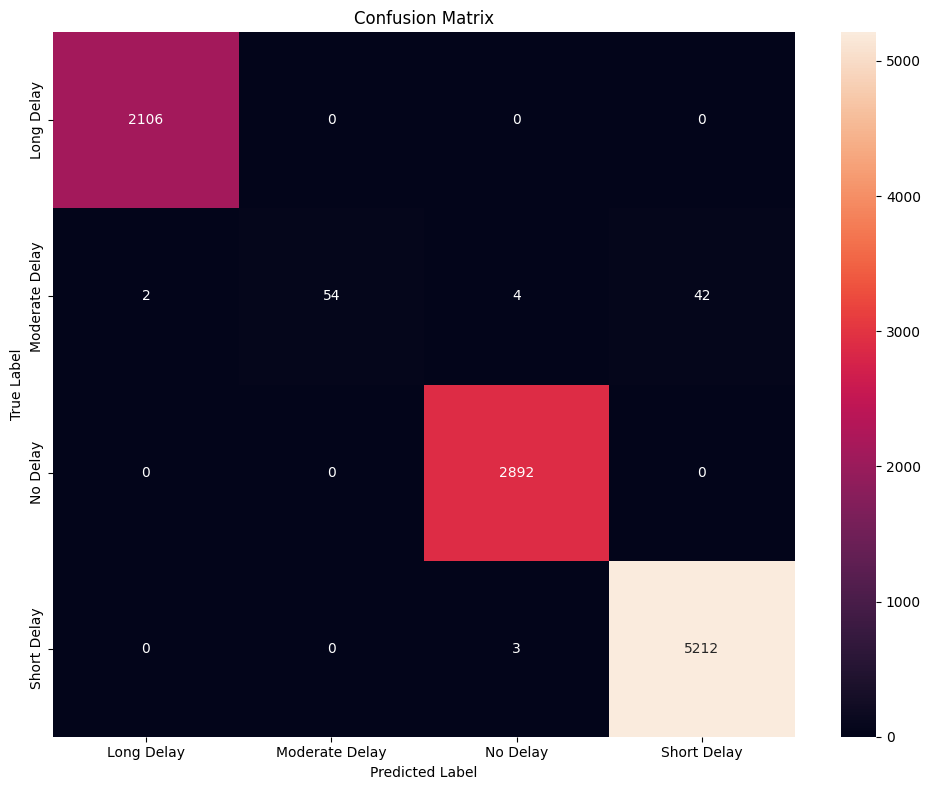

<Figure size 1000x600 with 0 Axes>

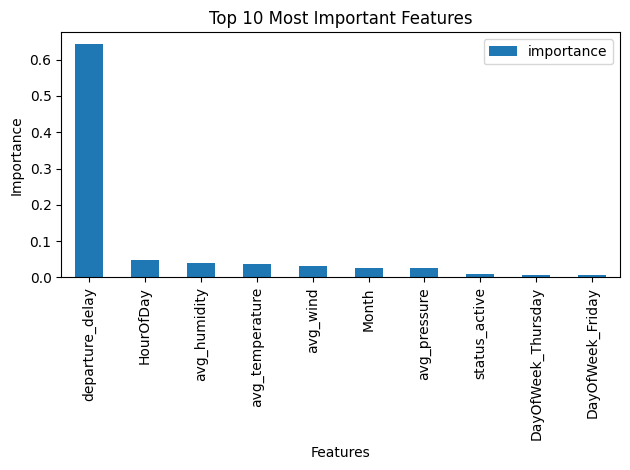


Overall Performance Metrics:
Accuracy: 0.9951
Precision: 0.9951
Recall: 0.9951
F1 Score: 0.9943


In [856]:
# Confusion Matrix Visualization
plt.figure(figsize=(10, 8))
cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', 
            xticklabels=rf_pipeline.named_steps['classifier'].classes_,
            yticklabels=rf_pipeline.named_steps['classifier'].classes_)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.tight_layout()
plt.show()

# Feature Importance
feature_names = (
    numerical_features + 
    list(rf_pipeline.named_steps['preprocessor']
         .named_transformers_['cat']
         .get_feature_names_out(categorical_features))
)
feature_importance = rf_pipeline.named_steps['classifier'].feature_importances_

features_df = pd.DataFrame({
    'feature': feature_names,
    'importance': feature_importance
}).sort_values('importance', ascending=False)

plt.figure(figsize=(10, 6))
features_df.head(10).plot(x='feature', y='importance', kind='bar')
plt.title('Top 10 Most Important Features')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.tight_layout()
plt.show()

# Output Metrics
print("\nOverall Performance Metrics:")
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

TESTING ON TEST DATA

In [857]:
X_testb = preprocessor.transform(merged_test)
# Ensure the test data undergoes the same preprocessing pipeline
y_predb = rf_pipeline.predict(merged_test)




In [858]:
merged_test['predicted_delay_cat'] = y_predb

In [859]:
# Save to a CSV file
#b_pred = merged_test.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\b_predictions.csv', index=False)
m_pred = merged_test['predicted_delay_cat']
m_pred.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\m_predictions.csv', index=False)
mp = pd.read_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\m_predictions.csv')
mp['ID'] = np.arange(1, len(mp) + 1)

mp = mp[['ID','predicted_delay_cat']]
mp.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\m_predictions.csv', index=False)
mp = pd.read_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\m_predictions.csv')



In [860]:
# Randomly select rows to keep after dropping 1996 rows
mp = mp.sample(n=len(mp) - 1996, random_state=42).reset_index(drop=True)

# Reassign the 'ID' column to range from 1 to the new length of the DataFrame
mp['ID'] = range(1, len(mp) + 1)

# Display the updated DataFrame
mp





,ID,predicted_delay_cat
0,1,No Delay
1,2,Long Delay
2,3,No Delay
3,4,Long Delay
4,5,Long Delay
...,...,...
12909,12910,No Delay
12910,12911,Long Delay
12911,12912,Long Delay
12912,12913,No Delay


In [861]:
mp.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\m_predictions.csv', index=False)

In [ ]:
# # Predictions
# y_predt = rf_pipeline.predict(merged_test)

# # Comprehensive Evaluation
# # Accuracy
# accuracy = accuracy_score(y_test, y_predt)

# # Precision, Recall, F1-Score
# precision, recall, f1, _ = precision_recall_fscore_support(
#     y_test, y_pred, average='weighted'
# )

# # Detailed Classification Report
# print("Comprehensive Classification Report:")
# print(classification_report(y_test, y_pred))


REGRESSION MODEL

In [903]:
merged_df.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\merged.csv', index=False)

In [ ]:

# 4. Create binary flags for peak traffic hours (6-9 AM, 4-8 PM)
merged_df['is_peak_hour'] = merged_df['HourOfDay'].apply(lambda x: 1 if (6 <= x <= 9 or 16 <= x <= 20) else 0)

merged_df['discomfort_index'] = merged_df['avg_temperature'] + merged_df['avg_humidity']

# 6. Create interaction terms between weather and time features
merged_df['temp_wind_interaction'] = merged_df['avg_temperature'] * merged_df['avg_wind']
merged_df['humidity_pressure_interaction'] = merged_df['avg_humidity'] * merged_df['avg_pressure']



,type,status,departure_iataCode,departure_icaoCode,departure_terminal,departure_scheduledTime,departure_estimatedTime,departure_actualTime,departure_estimatedRunway,departure_actualRunway,...,avg_pressure,min_pressure,DayOfWeek,HourOfDay,Month,departure_delay,is_peak_hour,discomfort_index,temp_wind_interaction,humidity_pressure_interaction
0,departure,active,lhe,opla,m,2023-07-20 20:50:00,2023-07-20 20:00:00,2023-07-20 20:15:00.000000000,2023-07-20 20:15:00.000000000,2023-07-20 20:15:00.000000000,...,28.7,28.8,Thursday,20,7,-35.000000,1,141.0,0.0,1693.3
1,departure,active,lhe,opla,m,2023-07-18 15:05:00,2023-07-18 15:05:00,2023-07-22 21:27:00.000000000,2023-07-22 21:27:00.000000000,2023-07-22 21:27:00.000000000,...,28.8,28.9,Tuesday,15,7,6142.000000,0,184.0,1140.0,2563.2
2,departure,active,lhe,opla,m,2023-07-23 09:50:00,2023-07-22 19:17:30,2023-07-24 22:39:00.000000000,2023-07-24 22:39:00.000000000,2023-07-24 22:39:00.000000000,...,28.7,28.8,Sunday,9,7,2209.000000,1,147.0,0.0,1808.1
3,departure,active,lhe,opla,m,2023-07-26 23:30:00,2023-07-26 23:30:00,2023-07-26 23:51:00.000000000,2023-07-26 23:51:00.000000000,2023-07-26 23:51:00.000000000,...,28.7,28.8,Wednesday,23,7,21.000000,0,156.0,0.0,2152.5
4,departure,active,lhe,opla,m,2023-07-20 11:35:00,2023-07-20 17:15:00,2023-07-26 15:08:34.285714176,2023-07-26 15:08:34.285714176,2023-07-26 15:08:34.285714176,...,28.7,28.8,Thursday,11,7,8853.571429,0,141.0,0.0,1693.3


In [ ]:
# Calculate IQR
Q1 = merged_df['departure_delay'].quantile(0.25)
Q3 = merged_df['departure_delay'].quantile(0.75)
IQR = Q3 - Q1

# Define outlier bounds
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR



In [909]:
filtered_df = merged_df[(merged_df['departure_delay'] >= lower_bound) & (merged_df['departure_delay'] <= upper_bound)]
filtered_df

,type,status,departure_iataCode,departure_icaoCode,departure_terminal,departure_scheduledTime,departure_estimatedTime,departure_actualTime,departure_estimatedRunway,departure_actualRunway,...,avg_pressure,min_pressure,DayOfWeek,HourOfDay,Month,departure_delay,is_peak_hour,discomfort_index,temp_wind_interaction,humidity_pressure_interaction
0,departure,active,lhe,opla,m,2023-07-20 20:50:00,2023-07-20 20:00:00,2023-07-20 20:15:00,2023-07-20 20:15:00,2023-07-20 20:15:00,...,28.7,28.8,Thursday,20,7,-35.0,1,141.0,0.00,1693.30
3,departure,active,lhe,opla,m,2023-07-26 23:30:00,2023-07-26 23:30:00,2023-07-26 23:51:00,2023-07-26 23:51:00,2023-07-26 23:51:00,...,28.7,28.8,Wednesday,23,7,21.0,0,156.0,0.00,2152.50
10,departure,active,lhe,opla,m,2023-07-24 10:45:00,2023-07-24 10:45:00,2023-07-24 10:54:00,2023-07-24 10:54:00,2023-07-24 10:54:00,...,28.8,28.8,Monday,10,7,9.0,0,190.0,2070.00,2880.00
14,departure,active,lhe,opla,m,2023-07-27 03:30:00,2023-07-27 03:30:00,2023-07-27 03:36:00,2023-07-27 03:36:00,2023-07-27 03:36:00,...,28.9,28.8,Thursday,3,7,6.0,0,184.0,1140.00,2572.10
15,departure,active,lhe,opla,m,2023-07-23 09:55:00,2023-07-25 00:20:00,2023-07-23 10:00:00,2023-07-23 10:00:00,2023-07-23 10:00:00,...,28.7,28.8,Sunday,9,7,5.0,1,147.0,0.00,1808.10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51561,departure,active,lhe,opla,m,2023-12-01 04:20:00,2023-12-01 04:35:00,2023-12-01 04:51:00,2023-12-01 04:51:00,2023-12-01 04:51:00,...,29.2,0.0,Friday,4,12,31.0,0,133.0,64.57,2169.56
51566,departure,active,lhe,opla,m,2023-11-28 21:40:00,2023-11-22 07:12:30,2023-11-28 21:58:00,2023-11-28 21:58:00,2023-11-28 21:58:00,...,29.4,29.4,Tuesday,21,11,18.0,0,165.0,924.00,2587.20
51567,departure,active,lhe,opla,m,2023-11-16 09:50:00,2023-11-16 09:50:00,2023-11-16 10:03:00,2023-11-16 10:03:00,2023-11-16 10:03:00,...,29.4,29.4,Thursday,9,11,13.0,1,161.0,553.00,2410.80
51568,departure,active,lhe,opla,m,2023-11-16 11:40:00,2023-11-16 11:40:00,2023-11-16 11:48:00,2023-11-16 11:48:00,2023-11-16 11:48:00,...,29.4,29.4,Thursday,11,11,8.0,0,161.0,553.00,2410.80


In [958]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

#'departure_iataCode','departure_icaoCode','arrival_iataCode','arrival_icaoCode',
# Features and Target
categorical_features1 = [
    'DayOfWeek', 'airline_name', 'status', 
    'type', 'departure_terminal'
]
numerical_features1 = [
    'Month', 'avg_pressure', 'avg_temperature', 
    'avg_humidity', 'avg_wind', 'HourOfDay'
]


# Splitting data into features (X) and target (y)
X = filtered_df[categorical_features1 + numerical_features1]
y = filtered_df['departure_delay']

# Splitting into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_features1),  # Scale numerical features
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features1)  # Encode categorical features
    ]
)

# Pipeline with preprocessing and Random Forest Regressor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', RandomForestRegressor(n_estimators=100, random_state=42))
])

# Fitting the Random Forest model
pipeline.fit(X_train, y_train)

# Making predictions on the training set (optional for training error analysis)
y_train_pred = pipeline.predict(X_train)

# Evaluating the model on the training data
mse_train = mean_squared_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

print("Training Mean Squared Error:", mse_train)
print("Training R-squared:", r2_train)


Training Mean Squared Error: 25.621589485324787
Training R-squared: 0.849929395185775


In [920]:

# 4. Create binary flags for peak traffic hours (6-9 AM, 4-8 PM)
merged_test['is_peak_hour'] = merged_test['HourOfDay'].apply(lambda x: 1 if (6 <= x <= 9 or 16 <= x <= 20) else 0)

merged_test['discomfort_index'] = merged_test['avg_temperature'] + merged_test['avg_humidity']

# 6. Create interaction terms between weather and time features
merged_test['temp_wind_interaction'] = merged_test['avg_temperature'] * merged_test['avg_wind']
merged_test['humidity_pressure_interaction'] = merged_test['avg_humidity'] * merged_test['avg_pressure']



In [959]:
y_train_pred1 = pipeline.predict(merged_test)



In [960]:
merged_test['pred_dep_delay'] = y_train_pred1


In [961]:
# Save to a CSV file
#b_pred = merged_test.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\b_predictions.csv', index=False)
r_pred = merged_test['pred_dep_delay']
r_pred.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\r_predictions.csv', index=False)
rp = pd.read_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\r_predictions.csv')
rp['ID'] = np.arange(1, len(rp) + 1)

rp = rp[['ID','pred_dep_delay']]
rp.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\r_predictions.csv', index=False)
rp = pd.read_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\r_predictions.csv')



In [962]:
# Randomly select rows to keep after dropping 1996 rows
rp = rp.sample(n=len(rp) - 1996, random_state=42).reset_index(drop=True)

# Reassign the 'ID' column to range from 1 to the new length of the DataFrame
rp['ID'] = range(1, len(rp) + 1)

# Display the updated DataFrame
rp





,ID,pred_dep_delay
0,1,31.914000
1,2,16.045000
2,3,9.435000
3,4,11.846000
4,5,13.136500
...,...,...
12909,12910,5.972500
12910,12911,31.600000
12911,12912,11.035000
12912,12913,10.160333


In [963]:
rp.to_csv(r'C:\Users\emadh\Downloads\ML-Proj-Dataset\ML-Proj-Dataset\r_predictions.csv', index=False)